In [230]:
import os
import sys
sys.path.append('C:\\Users\\dhruv\\Anaconda3\\envs\\testPanorama\\Lib\\site-packages')
import cv2
import numpy as np
import matplotlib.pyplot as plt
import imageio
import imutils
from imutils import paths
from sklearn.datasets import make_classification
from sklearn.cluster import MeanShift
from matplotlib import pyplot
import random
import pickle
import csv

In [231]:
!export PATH=/Library/TeX/texbin:$PATH

'export' is not recognized as an internal or external command,
operable program or batch file.


In [97]:
# a = np.array([[0,60], [1,2], [3,4]])
# b = np.array([[12,23],[68,26]])
# a = a.ravel()
# print(a)
# a = a.reshape(-1, a.shape[0])
# b = b.ravel()
# b = b.reshape(-1, b.shape[0])
# print(a.shape)
# print(a)

# list = [a,b]
# print(type(list))
# print(len(list))
# print(tuple(list))

# with open('coordinatesFromPostProcessing-dummy.csv', 'ab') as f:
#     np.savetxt(f, a, delimiter=',')
#     np.savetxt(f, b, delimiter=',')

[ 0 60  1  2  3  4]
(1, 6)
[[ 0 60  1  2  3  4]]
<class 'list'>
2
(array([[ 0, 60,  1,  2,  3,  4]]), array([[12, 23, 68, 26]]))


ValueError: could not broadcast input array from shape (6) into shape (1)

In [232]:
feature_extractor = 'sift' # one of 'sift', 'surf', 'brisk', 'orb'
feature_matching = 'bf'
imgPath = "F:\\IIIT-H Work\\win_det_heatmaps\\datasets\\IIIT-H Dataset\\Bakul-All\\001\\images\\"
windowCount = 0

In [233]:
# Displaying the contents of the text file

# del list

with open('..\\win_det_heatmaps\coordinatesFromPostProcessing-1.csv', newline='') as f:
    csvread = csv.reader(f)
    print(csvread)
    batch_data = list(csvread)
print(len(batch_data))

23


In [234]:
print(batch_data[0])


batch_data_int = []
for inner_list in batch_data:
    innet_out_list = []
    for string in inner_list:
        innet_out_list.append(int(float(string)))
    batch_data_int.append(innet_out_list)

print(batch_data_int)
print(len(batch_data_int))
print(batch_data_int[1][0])
FinalList = []
for i in range(len(batch_data_int)):
    el = batch_data_int[i]
    elChunks = [el[x:x+4] for x in range(0, len(el), 4)]
    print("elChunks:", elChunks)
    newElChunks = elChunks.copy()
    for i in range(len(elChunks)):
#         newChunk = newElChunks[i]        
        chunk = elChunks[i]
        newChunk = chunk.copy()
        print("newChunk", newChunk)
        print("chunk", chunk)
        newChunk.insert(2, chunk[0])
        newChunk.insert(3, chunk[3])
        newChunk.insert(6, chunk[2])
        newChunk.insert(7, chunk[1])
        print("newModifiedChunk", newChunk)
        newElChunks[i] = newChunk
    print(newElChunks)
    perImageCoords = np.array(newElChunks)
    perImageCoords = perImageCoords.reshape(-1,4,2)
    FinalList.append(perImageCoords)

print("Final list:", FinalList)
print("Final list size:", len(FinalList))
print("Final list:", FinalList[0].shape)
print("Final list:", FinalList[0])

['1.890000000000000000e+02', '0.000000000000000000e+00', '3.890000000000000000e+02', '1.420000000000000000e+02', '5.980000000000000000e+02', '0.000000000000000000e+00', '7.930000000000000000e+02', '1.400000000000000000e+02']
[[189, 0, 389, 142, 598, 0, 793, 140], [607, 45, 797, 222, 217, 47, 410, 222], [223, 195, 413, 355, 604, 195, 789, 352], [240, 315, 430, 460, 617, 307, 799, 455], [640, 390, 780, 495], [647, 452, 790, 550], [650, 480, 787, 575, 290, 470, 430, 565, 0, 460, 80, 552, 665, 50, 820, 197], [612, 500, 750, 590, 260, 492, 397, 582, 222, 60, 417, 235, 610, 60, 800, 232], [645, 560, 782, 647], [652, 575, 792, 662, 302, 565, 437, 647], [667, 620, 807, 697, 322, 602, 452, 680, 692, 207, 842, 342, 305, 202, 457, 332], [605, 622, 737, 695, 262, 615, 397, 690, 225, 210, 415, 367, 620, 225, 767, 352], [340, 645, 467, 715, 700, 265, 850, 395, 325, 255, 470, 380], [625, 645, 752, 715, 282, 637, 412, 705, 637, 250, 787, 377, 265, 245, 415, 370], [27, 642, 145, 710, 330, 282, 480, 400

In [235]:
def calculateRange(coordinates, padding, imageShape):
    minX = maxX = coordinates[0][0]
    minY = maxY = coordinates[0][1]
    startX = startY = endX = endY = 0
    h,w,c = imageShape
    for i in range(len(coordinates)):
        if minX > coordinates[i][0]:
            minX = coordinates[i][0]
        if maxX < coordinates[i][0]:
            maxX = coordinates[i][0]

        if minY > coordinates[i][1]:
            minY = coordinates[i][1]
        if maxY < coordinates[i][1]:
            maxY = coordinates[i][1]
    
    if (minX - padding < 0):
        startX = 0
    else:
        startX = minX - padding
    if (minY - padding < 0):
        startY = 0
    else:
        startY = minY - padding
    if (maxX + padding >= w):
        endX = w - 1
    else:
        endX = maxX + padding
    if (maxY + padding >= h):
        endY = h - 1
    else:
        endY = maxY + padding
    return startX, endX, startY, endY

def prepareBinaryMask(img_gray, coordinates):
    ret, binary_img = cv2.threshold(img_gray, 255, 255, cv2.THRESH_BINARY)
    for i in range(coordinates.shape[0]):
        startX, endX, startY, endY = calculateRange(coordinates[i], 5, (720,960,3))
        binary_img[startY:endY, startX:endX] = 1
    return binary_img

def mapToPick(coordinates):
    pick = []
    for i in range(coordinates.shape[0]):
        startX, endX, startY, endY = calculateRange(coordinates[i], 5, (720,960,3))
        pick.append([startX, startY, endX, endY])
    return pick

def mapToPickv1(coordinates):
    pick = []
    for i in range(coordinates.shape[0]):
        startX, startY = coordinates[i][0]
        endX, endY = coordinates[i][2]
        pick.append([startX, startY, endX, endY])
    return pick
    

In [236]:
ans = mapToPickv1(FinalList[4])
print(len(ans))

1








# SIFT Feature Matching on Bounding Box Descriptors(Window masks):




In [237]:
def detectAndDescribe(image, mask, method=None):
    """
    Compute key points and feature descriptors using an specific method
    """
    
    assert method is not None, "You need to define a feature detection method. Values are: 'sift', 'surf'"
    
    # detect and extract features from the image
    if method == 'sift':
        descriptor = cv2.xfeatures2d.SIFT_create()
    elif method == 'surf':
        descriptor = cv2.xfeatures2d.SURF_create()
    elif method == 'brisk':
        descriptor = cv2.BRISK_create()
    elif method == 'orb':
        descriptor = cv2.ORB_create()
        
    # get keypoints and descriptors
    (kps, features) = descriptor.detectAndCompute(image, mask)
#     kps = np.float32([kp.pt for kp in kps])
    return (kps, features)

def createMatcher(method,crossCheck):
    "Create and return a Matcher Object"
    
    if method == 'sift' or method == 'surf':
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=crossCheck)
    elif method == 'orb' or method == 'brisk':
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=crossCheck)
    return bf

def matchKeyPointsBF(featuresA, featuresB, method):
    bf = createMatcher(method, crossCheck=True)
        
    # Match descriptors.
    best_matches = bf.match(featuresA,featuresB)
    
    # Sort the features in order of distance.
    # The points with small distance (more similarity) are ordered first in the vector
    rawMatches = sorted(best_matches, key = lambda x:x.distance)
    print("Raw matches (Brute force):", len(rawMatches))
    return rawMatches

def matchKeyPointsKNN(featuresA, featuresB, ratio, method):
    bf = createMatcher(method, crossCheck=False)
    # compute the raw matches and initialize the list of actual matches
    rawMatches = bf.knnMatch(featuresA, featuresB, 2)
    print("Raw matches (knn):", len(rawMatches))
    print(rawMatches)
    matches = []

    # loop over the raw matches
    for m,n in rawMatches:
        print('m: ' + str(m) + ' n: ' + str(n))
        # ensure the distance is within a certain ratio of each
        # other (i.e. Lowe's ratio test)
        if m.distance < n.distance * ratio:
            matches.append(m)
    return matches







# Homography Calculation and Outlier Rejection





In [238]:
#
# Computers a homography from 4-correspondences
#
def calculateHomography(correspondences):
    #loop through correspondences and create assemble matrix
    aList = []
    for corr in correspondences:
        p1 = np.matrix([corr.item(0), corr.item(1), 1])
        p2 = np.matrix([corr.item(2), corr.item(3), 1])

        a2 = [0, 0, 0, -p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2),
              p2.item(1) * p1.item(0), p2.item(1) * p1.item(1), p2.item(1) * p1.item(2)]
        a1 = [-p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2), 0, 0, 0,
              p2.item(0) * p1.item(0), p2.item(0) * p1.item(1), p2.item(0) * p1.item(2)]
        aList.append(a1)
        aList.append(a2)

    matrixA = np.matrix(aList)

    #svd composition
    u, s, v = np.linalg.svd(matrixA)

    #reshape the min singular value into a 3 by 3 matrix
    h = np.reshape(v[8], (3, 3))

    #normalize and now we have h
    h = (1/h.item(8)) * h
    return h


#
#Calculate the geometric distance between estimated points and original points
#
def geometricDistance(correspondence, h):
#     print("H: ", h)
#     print("correspondence: ", correspondence)
    p1 = np.transpose(np.matrix([correspondence[0].item(0), correspondence[0].item(1), 1]))
    estimatep2 = np.dot(h, p1)
#     print("estimatep2: ", estimatep2)
#     print(estimatep2.item(2))
    if estimatep2.item(2) == 0:
        return None
    estimatep2 = (1/estimatep2.item(2))*estimatep2
    
#     print("TRANSFORMED estimatep2: ", estimatep2)
    p2 = np.transpose(np.matrix([correspondence[0].item(2), correspondence[0].item(3), 1]))
    error = p2 - estimatep2
    return np.linalg.norm(error)


#
#Runs through ransac algorithm, creating homographies from random correspondences
#
def ransac(corr, thresh):
    maxInliers = []
    finalH = None
    for i in range(1000):
        #find 4 random points to calculate a homography
        corr1 = corr[random.randrange(0, len(corr))]
        corr2 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((corr1, corr2))
        corr3 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((randomFour, corr3))
        corr4 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((randomFour, corr4))

        #call the homography function on those points
        h = calculateHomography(randomFour)
        inliers = []
        continueFlag = False 
        
        for i in range(len(corr)):
            d = geometricDistance(corr[i], h)
            
            ## set the flag if divide by zero error
            if d == None:
                continueFlag = True
                break
            if d < 5:
                inliers.append(corr[i])
        
        ## Skip the set if divide by zero error
        if(continueFlag == True):
            continue
            
        if len(inliers) > len(maxInliers):
            maxInliers = inliers
            finalH = h
#         print("Corr size: ", len(corr), " NumInliers: ", len(inliers), "Max inliers: ", len(maxInliers))

        if len(maxInliers) > (len(corr)*thresh):
            break
    return finalH, maxInliers

# This draws matches and optionally a set of inliers in a different color
# Note: I lifted this drawing portion from stackoverflow and adjusted it to my needs because OpenCV 2.4.11 does not
# include the drawMatches function
def drawMatches(img1, kp1, img2, kp2, matches, inliers = None):
    print(img1.shape)
    print(img2.shape)
    # Create a new output image that concatenates the two images together
    rows1 = img1.shape[0]
    cols1 = img1.shape[1]
    rows2 = img2.shape[0]
    cols2 = img2.shape[1]

    out = np.zeros((max([rows1,rows2]),cols1+cols2,3), dtype='uint8')

    # Place the first image to the left
    print(np.dstack([img1, img1, img1]).shape)
    out[:rows1,:cols1,:] = img1 #np.dstack([img1, img1, img1])

    # Place the next image to the right of it
    out[:rows2,cols1:cols1+cols2,:] = img2 #np.dstack([img2, img2, img2])

    # For each pair of points we have between both images
    # draw circles, then connect a line between them
    for mat in matches:

        # Get the matching keypoints for each of the images
        img1_idx = mat.queryIdx
        img2_idx = mat.trainIdx

        # x - columns, y - rows
        (x1,y1) = kp1[img1_idx].pt
        (x2,y2) = kp2[img2_idx].pt

        inlier = False

        if inliers is not None:
            for i in inliers:
                if i.item(0) == x1 and i.item(1) == y1 and i.item(2) == x2 and i.item(3) == y2:
                    inlier = True

        # Draw a small circle at both co-ordinates
        cv2.circle(out, (int(x1),int(y1)), 4, (255, 0, 0), 1)
        cv2.circle(out, (int(x2)+cols1,int(y2)), 4, (255, 0, 0), 1)

        # Draw a line in between the two points, draw inliers if we have them
        if inliers is not None and inlier:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (0, 255, 0), 1)
        elif inliers is not None:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (0, 0, 255), 1)

        if inliers is None:
            cv2.line(out, (int(x1),int(y1)), (int(x2)+cols1,int(y2)), (255, 0, 0), 1)

    return out

In [239]:
## Calculating homography and rejecting outliers

def rejectOutliers(matches, img1, img2, kpsA, kpsB, estimation_thresh = 0.60):
    correspondenceList = []
    for match in matches:
        (x1, y1) = kpsA[match.queryIdx].pt
        (x2, y2) = kpsB[match.trainIdx].pt
        correspondenceList.append([x1, y1, x2, y2])

    corrs = np.matrix(correspondenceList)

    #run ransac algorithm
    finalH, inliers = ransac(corrs, estimation_thresh)
    print("Final homography: ", finalH)
    print("Final inliers count: ", len(inliers))
    print("Inliers: " +  str(inliers))

    img3 = drawMatches(img1,kpsA,img2,kpsB, matches, inliers)
    plt.figure(figsize=(15,15))
    plt.imshow(img3)
    plt.show()

    # for inlier in inliers:
    #     print(inlier[0][0])

    ## Converting to numpy array = INLIERS
    inliers_Arr = np.array(inliers)
    inliers = np.squeeze(inliers_Arr, axis = 1).tolist()
    print(inliers)
    
    return inliers





# Calculation of New Unmatched Windows from inliers in Current Frame:



In [240]:
## For calculation of new Windows in the current Frame
## Take care of many one correspondences even after outlier rejection!!!!

def isInsideBox(rectCoords, coords):
    sX, sY, eX, eY = rectCoords
    x, y = coords
    if x >= sX and x <= eX and y >= sY and y <= eY:
        return True
    return False

def calculateUnMatchedWindows(inliers, picksA, picksB):
    clusterInfoA = []
    clusterInfoB = []
    id1 = 1
    id2 = 1
    newWindowsCount = 0
    newWindows = []
    matchedWindowsInA = []
    
    for box in picksB:
        newBox = True
        print("box2: ", box)
        for inlier in inliers:
            ptA = (int(inlier[0]), int(inlier[1]))
            ptB = (int(inlier[2]), int(inlier[3]))
            print("pointB: ", ptB)
            ## Assign box from A to this inlier
            matchedWindowInA = None
            for box1 in picksA:
                if isInsideBox(box1, ptA) == True:
                    matchedWindowInA = box1
                    break
                    
            print("listA: ", matchedWindowsInA)
            print("ElementA: ", matchedWindowInA)
            print("count: ", matchedWindowsInA.count(matchedWindowInA))
            if isInsideBox(box, ptB) == True and (matchedWindowsInA.count(matchedWindowInA) == 0):
                print("oldBox")
                newBox = False
                matchedWindowsInA.append(matchedWindowInA)
                break
                    
        if newBox == True:
            newWindowsCount += 1 
            newWindows.append(box)
        print("newCountInItr:", newWindowsCount)
    
    print("new Windows Count: ", newWindowsCount)
    return newWindows, newWindowsCount

In [241]:
calculateUnMatchedWindows(inliers, pick, pick2)

box2:  [80, 507, 242, 610]
pointB:  (135, 158)
listA:  []
ElementA:  None
count:  0
pointB:  (135, 173)
listA:  []
ElementA:  None
count:  0
pointB:  (154, 510)
listA:  []
ElementA:  None
count:  0
oldBox
newCountInItr: 0
box2:  [37, 67, 222, 222]
pointB:  (135, 158)
listA:  [None]
ElementA:  None
count:  1
pointB:  (135, 173)
listA:  [None]
ElementA:  None
count:  1
pointB:  (154, 510)
listA:  [None]
ElementA:  None
count:  1
pointB:  (149, 547)
listA:  [None]
ElementA:  None
count:  1
pointB:  (159, 580)
listA:  [None]
ElementA:  None
count:  1
pointB:  (142, 585)
listA:  [None]
ElementA:  None
count:  1
pointB:  (171, 551)
listA:  [None]
ElementA:  None
count:  1
pointB:  (100, 216)
listA:  [None]
ElementA:  None
count:  1
pointB:  (108, 583)
listA:  [None]
ElementA:  None
count:  1
pointB:  (145, 601)
listA:  [None]
ElementA:  None
count:  1
pointB:  (135, 207)
listA:  [None]
ElementA:  None
count:  1
pointB:  (118, 211)
listA:  [None]
ElementA:  None
count:  1
pointB:  (132, 127)


([], 0)

[INFO] loading images...
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\001\images\Bakul_001_000060.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\001\images\Bakul_001_000110.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\001\images\Bakul_001_000230.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\001\images\Bakul_001_000330.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\001\images\Bakul_001_000380.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\001\images\Bakul_001_000420.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\001\images\Bakul_001_000450.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\001\images\Bakul_001_000480.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\001\images\Bakul_001_000510.png
F:\IIIT-H Work\win_det_heatmaps\datasets\IIIT-H Dataset\Bakul-All\001\images\Bakul_001_000530

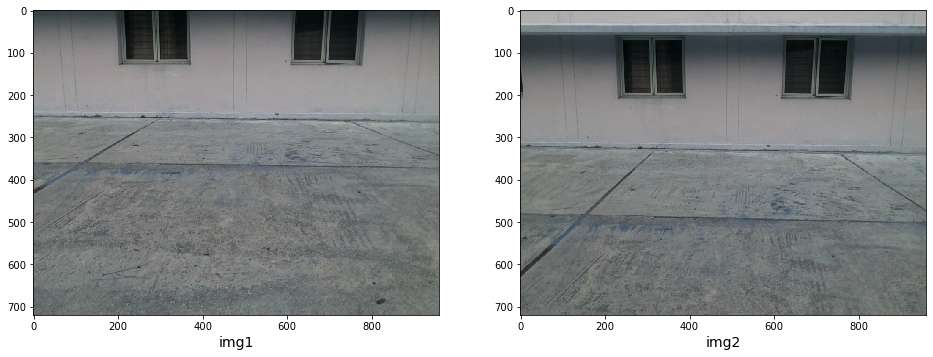

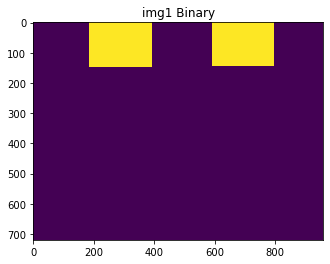

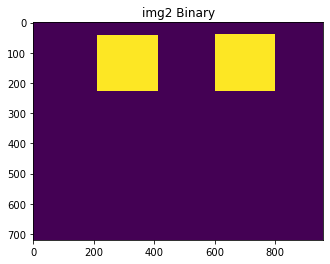

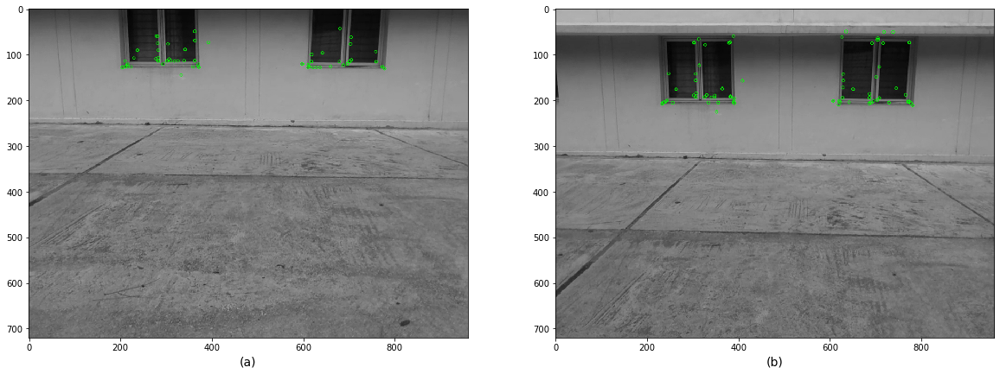

Using: bf feature matcher
Raw matches (Brute force): 62


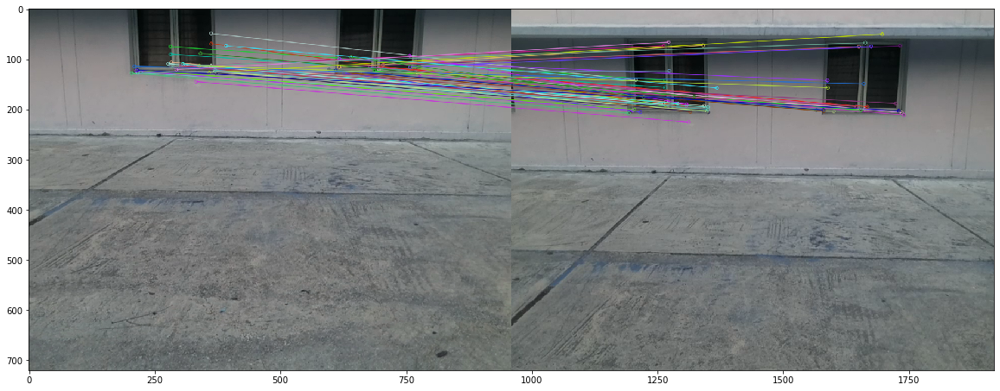

Final homography:  [[ 9.03455988e-01  1.03849201e-02  4.36534571e+01]
 [-1.12530059e-02  8.72092586e-01  9.39776984e+01]
 [-5.32556861e-05 -3.25107922e-05  1.00000000e+00]]
Final inliers count:  34
Inliers: [matrix([[772.58728027, 126.70591736, 776.33270264, 206.49778748]]), matrix([[772.58728027, 126.70591736, 776.33270264, 206.49778748]]), matrix([[369.77069092, 124.47389984, 388.77996826, 203.86811829]]), matrix([[325.76644897, 114.04667664, 347.40075684, 193.07252502]]), matrix([[696.35809326, 120.0007782 , 702.67388916, 199.34463501]]), matrix([[700.98040771, 115.50656128, 707.21484375, 194.82670593]]), matrix([[700.98040771, 115.50656128, 707.21484375, 194.82670593]]), matrix([[362.65405273, 113.09812927, 382.87091064, 192.79734802]]), matrix([[332.90322876, 144.78799438, 351.88031006, 225.37895203]]), matrix([[306.54180908, 109.77432251, 330.02679443, 188.29475403]]), matrix([[362.65405273, 113.09812927, 382.87091064, 192.79734802]]), matrix([[204.70599365, 127.97531128, 232.692

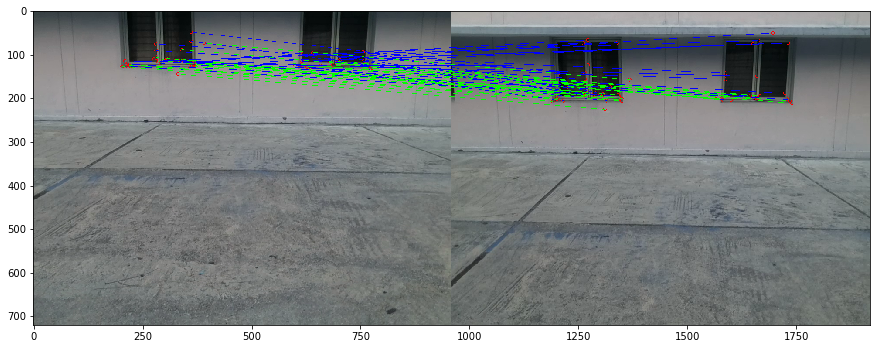

pick1: [[189, 0, 389, 142], [598, 0, 793, 140]]
pick2: [[607, 45, 797, 222], [217, 47, 410, 222]]
box2:  [607, 45, 797, 222]
pointB:  (776, 206)
listA:  []
ElementA:  [598, 0, 793, 140]
count:  0
oldBox
newCountInItr: 0
box2:  [217, 47, 410, 222]
pointB:  (776, 206)
listA:  [[598, 0, 793, 140]]
ElementA:  [598, 0, 793, 140]
count:  1
pointB:  (776, 206)
listA:  [[598, 0, 793, 140]]
ElementA:  [598, 0, 793, 140]
count:  1
pointB:  (388, 203)
listA:  [[598, 0, 793, 140]]
ElementA:  [189, 0, 389, 142]
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0


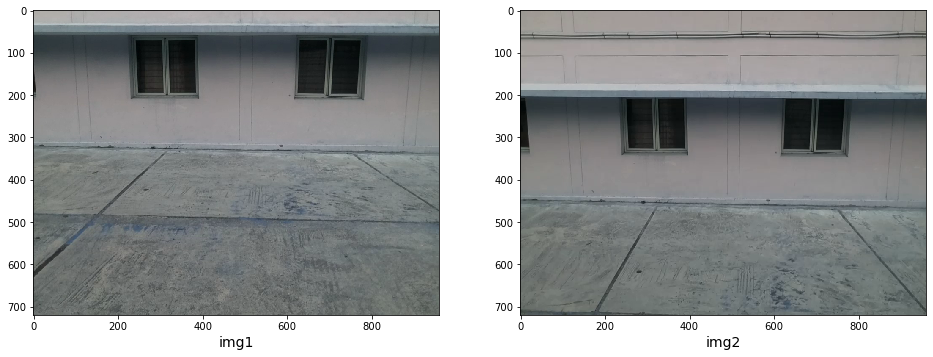

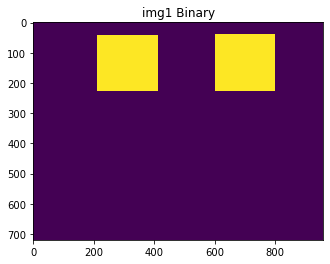

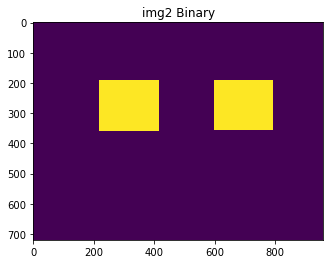

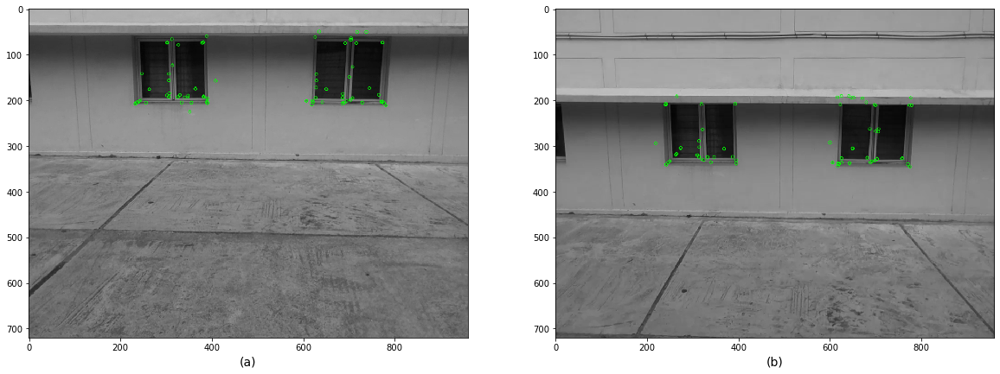

Using: bf feature matcher
Raw matches (Brute force): 55


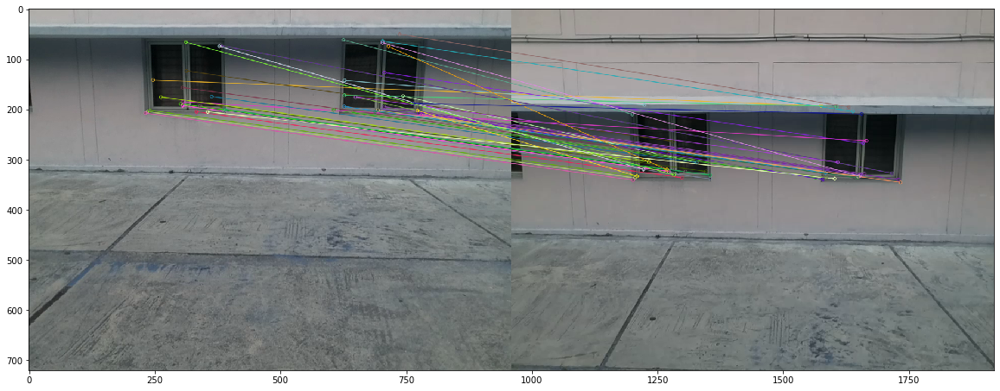

Final homography:  [[ 8.27981745e-01 -2.82940484e-01  6.26244622e+01]
 [ 1.03870528e-02  5.97597549e-01  1.54139486e+02]
 [ 3.89948005e-05 -9.18547202e-04  1.00000000e+00]]
Final inliers count:  31
Inliers: [matrix([[306.05496216, 156.52352905, 313.01309204, 288.9519043 ]]), matrix([[325.45806885, 192.75216675, 331.68756104, 323.98153687]]), matrix([[325.45806885, 192.75216675, 331.68756104, 323.98153687]]), matrix([[776.33270264, 206.49778748, 769.67767334, 339.7663269 ]]), matrix([[627.09844971, 194.42285156, 624.69250488, 326.35757446]]), matrix([[627.09844971, 194.42285156, 624.69250488, 326.35757446]]), matrix([[305.94891357, 192.65274048, 312.67782593, 323.5279541 ]]), matrix([[302.00192261, 189.28137207, 309.25241089, 319.91421509]]), matrix([[305.94891357, 192.65274048, 312.67782593, 323.5279541 ]]), matrix([[340.71768188, 193.26527405, 345.98193359, 324.12557983]]), matrix([[236.44721985, 204.72607422, 245.574646  , 336.51306152]]), matrix([[382.87091064, 192.79734802, 386.916

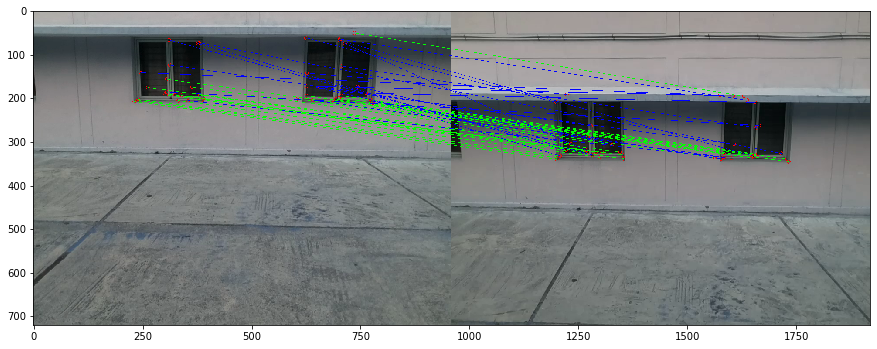

pick1: [[607, 45, 797, 222], [217, 47, 410, 222]]
pick2: [[223, 195, 413, 355], [604, 195, 789, 352]]
box2:  [223, 195, 413, 355]
pointB:  (313, 288)
listA:  []
ElementA:  [217, 47, 410, 222]
count:  0
oldBox
newCountInItr: 0
box2:  [604, 195, 789, 352]
pointB:  (313, 288)
listA:  [[217, 47, 410, 222]]
ElementA:  [217, 47, 410, 222]
count:  1
pointB:  (331, 323)
listA:  [[217, 47, 410, 222]]
ElementA:  [217, 47, 410, 222]
count:  1
pointB:  (331, 323)
listA:  [[217, 47, 410, 222]]
ElementA:  [217, 47, 410, 222]
count:  1
pointB:  (769, 339)
listA:  [[217, 47, 410, 222]]
ElementA:  [607, 45, 797, 222]
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0


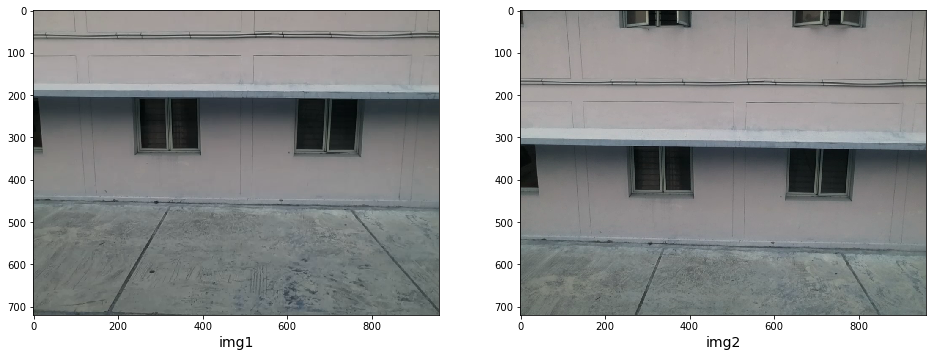

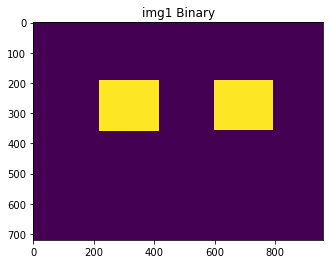

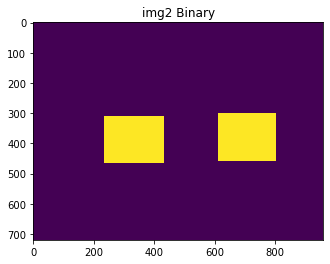

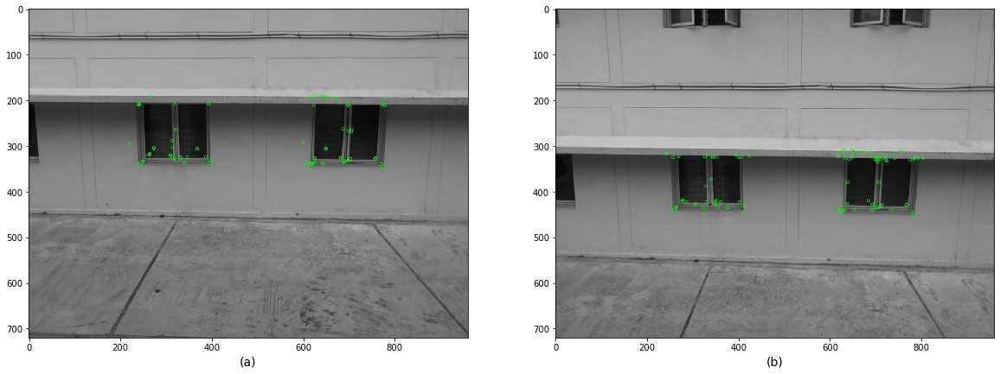

Using: bf feature matcher
Raw matches (Brute force): 51


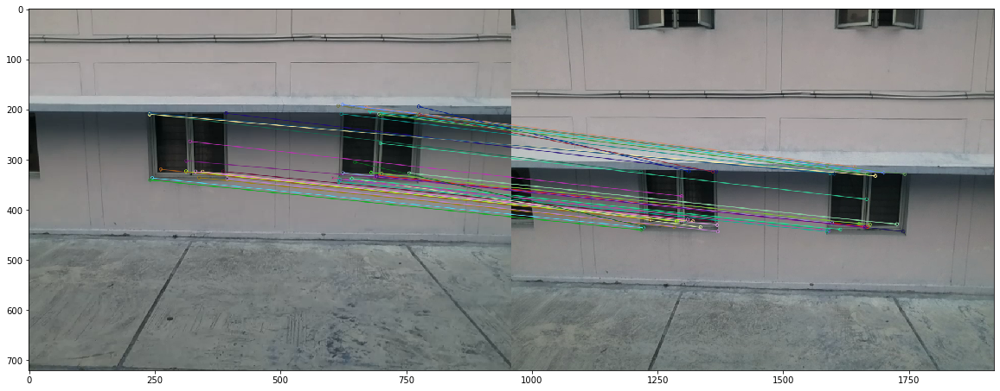

Final homography:  [[ 8.62851445e-01 -1.28312562e-01  6.62977656e+01]
 [-1.06180387e-03  6.42200692e-01  1.71381781e+02]
 [-2.74343304e-05 -2.95458590e-04  1.00000000e+00]]
Final inliers count:  31
Inliers: [matrix([[680.93481445, 325.83215332, 691.68823242, 427.61816406]]), matrix([[386.9168396 , 323.54345703, 401.01327515, 422.66390991]]), matrix([[262.4211731 , 319.54660034, 278.54312134, 417.71502686]]), matrix([[769.67767334, 339.7663269 , 779.04986572, 443.06121826]]), matrix([[245.574646  , 336.51306152, 262.59118652, 435.53936768]]), matrix([[331.68756104, 323.98153687, 346.59872437, 422.83685303]]), matrix([[756.83288574, 326.97988892, 766.60467529, 428.80401611]]), matrix([[345.98193359, 324.12557983, 360.80859375, 422.90365601]]), matrix([[394.75411987, 330.91021729, 408.85351562, 430.19232178]]), matrix([[245.574646  , 336.51306152, 262.59118652, 435.53936768]]), matrix([[392.35906982, 207.83224487, 407.11080933, 323.9430542 ]]), matrix([[680.93481445, 325.83215332, 691.688

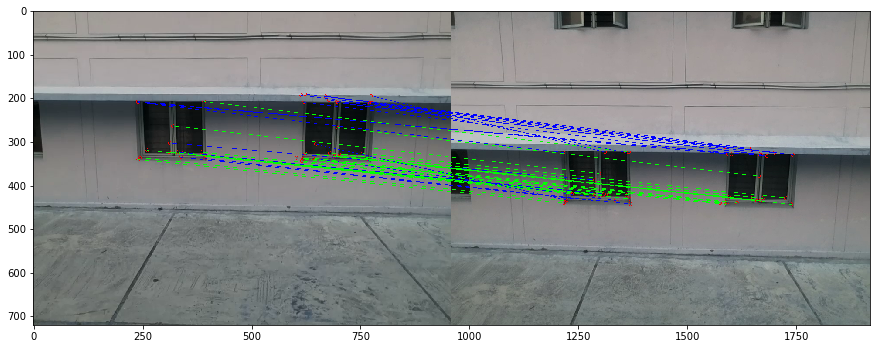

pick1: [[223, 195, 413, 355], [604, 195, 789, 352]]
pick2: [[240, 315, 430, 460], [617, 307, 799, 455]]
box2:  [240, 315, 430, 460]
pointB:  (691, 427)
listA:  []
ElementA:  [604, 195, 789, 352]
count:  0
pointB:  (401, 422)
listA:  []
ElementA:  [223, 195, 413, 355]
count:  0
oldBox
newCountInItr: 0
box2:  [617, 307, 799, 455]
pointB:  (691, 427)
listA:  [[223, 195, 413, 355]]
ElementA:  [604, 195, 789, 352]
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0


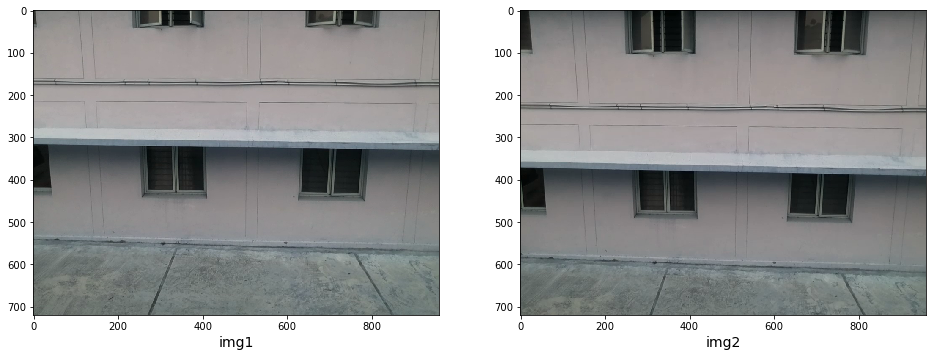

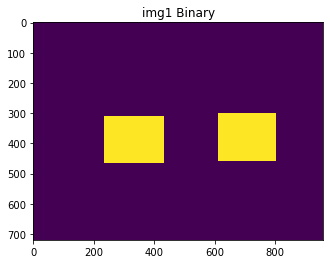

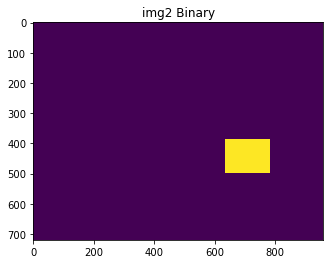

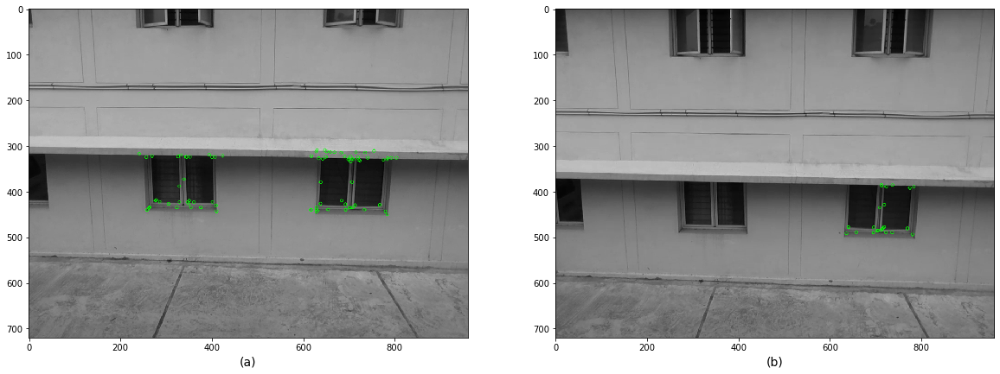

Using: bf feature matcher
Raw matches (Brute force): 24


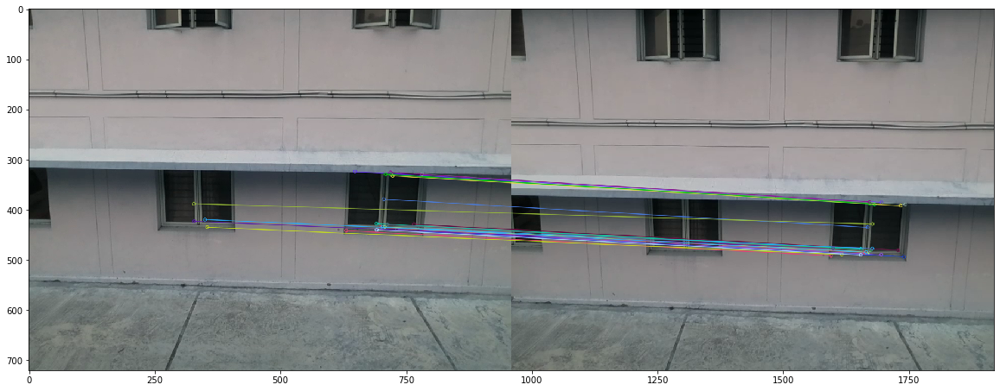

Final homography:  [[ 7.19612941e-01 -2.80299166e-01  1.62595746e+02]
 [-2.19391222e-02  5.56033605e-01  1.49641944e+02]
 [-7.45583444e-05 -3.96712736e-04  1.00000000e+00]]
Final inliers count:  17
Inliers: [matrix([[631.11657715, 441.51925659, 635.48657227, 491.54299927]]), matrix([[779.04986572, 443.06121826, 779.82281494, 493.61578369]]), matrix([[733.44525146, 439.4336853 , 735.27990723, 489.51599121]]), matrix([[720.9541626 , 330.2019043 , 722.29040527, 389.36227417]]), matrix([[713.07525635, 429.68161011, 715.26977539, 479.78833008]]), matrix([[705.84655762, 378.93740845, 707.96160889, 434.85827637]]), matrix([[708.2689209 , 434.12597656, 710.46691895, 484.52468872]]), matrix([[700.33966064, 435.08978271, 702.89624023, 485.01019287]]), matrix([[782.34918213, 329.15423584, 783.01049805, 389.17687988]]), matrix([[766.60467529, 428.80401611, 768.78088379, 480.44229126]]), matrix([[766.60467529, 428.80401611, 768.78088379, 480.44229126]]), matrix([[691.68823242, 427.61816406, 694.763

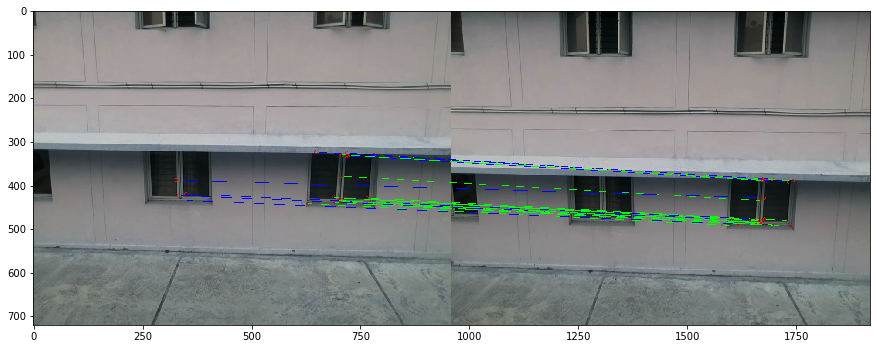

pick1: [[240, 315, 430, 460], [617, 307, 799, 455]]
pick2: [[640, 390, 780, 495]]
box2:  [640, 390, 780, 495]
pointB:  (635, 491)
listA:  []
ElementA:  [617, 307, 799, 455]
count:  0
pointB:  (779, 493)
listA:  []
ElementA:  [617, 307, 799, 455]
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0


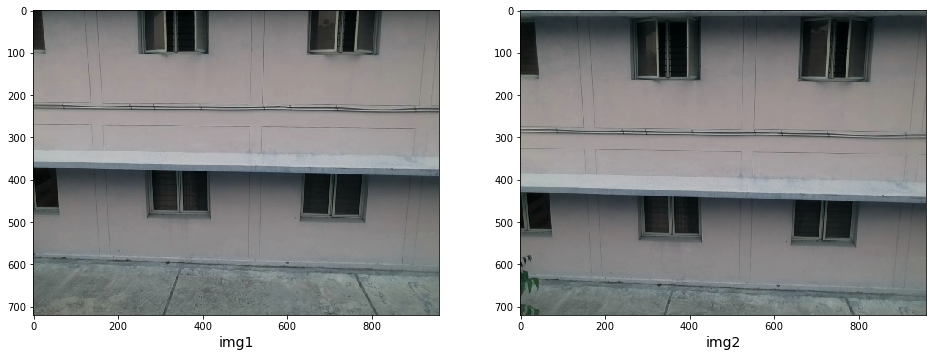

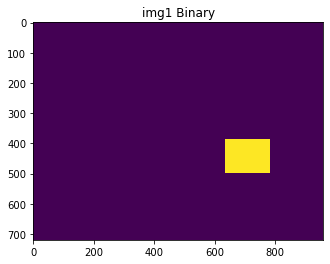

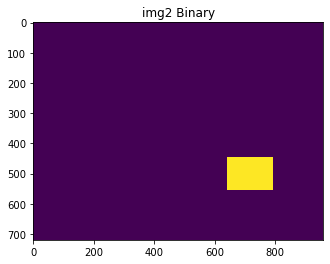

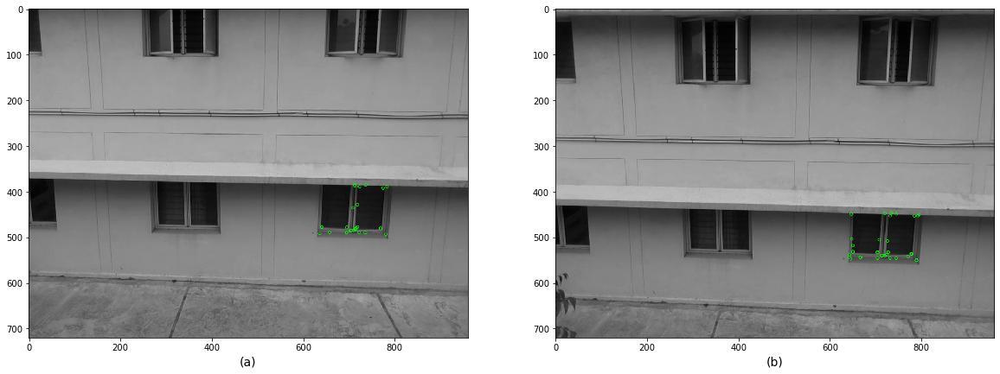

Using: bf feature matcher
Raw matches (Brute force): 22


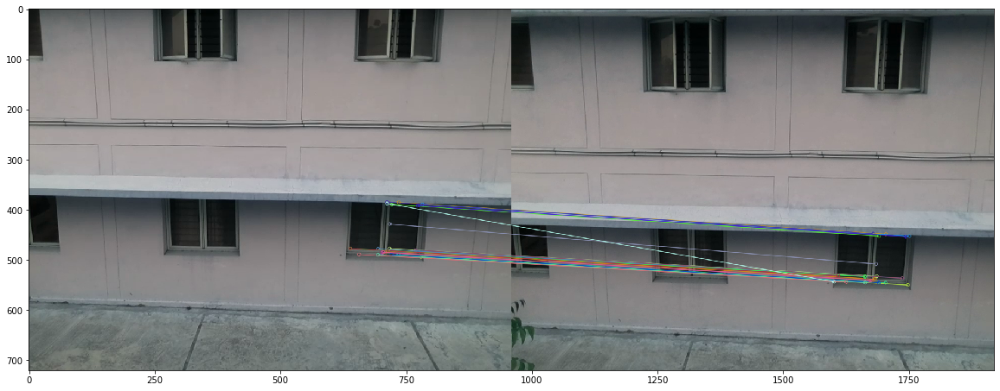

Final homography:  [[ 4.73302624e-01  1.23520713e-01  1.74058270e+02]
 [-2.05623924e-01  8.07320106e-01  1.83217591e+02]
 [-4.10000121e-04  1.74299069e-04  1.00000000e+00]]
Final inliers count:  19
Inliers: [matrix([[722.29040527, 389.36227417, 730.84783936, 452.28131104]]), matrix([[779.82281494, 493.61578369, 788.35296631, 549.87365723]]), matrix([[735.27990723, 489.51599121, 743.96704102, 545.24200439]]), matrix([[710.46691895, 484.52468872, 719.06066895, 539.75134277]]), matrix([[721.65759277, 489.44720459, 730.63580322, 545.05883789]]), matrix([[735.87084961, 385.44876099, 744.3157959 , 448.29721069]]), matrix([[717.46929932, 477.1897583 , 726.6973877 , 532.28491211]]), matrix([[783.01049805, 389.17687988, 791.16918945, 452.49264526]]), matrix([[768.78088379, 480.44229126, 777.29815674, 536.08050537]]), matrix([[702.89624023, 485.01019287, 711.55926514, 540.27020264]]), matrix([[713.84490967, 481.88586426, 722.36486816, 537.88037109]]), matrix([[768.78088379, 480.44229126, 777.298

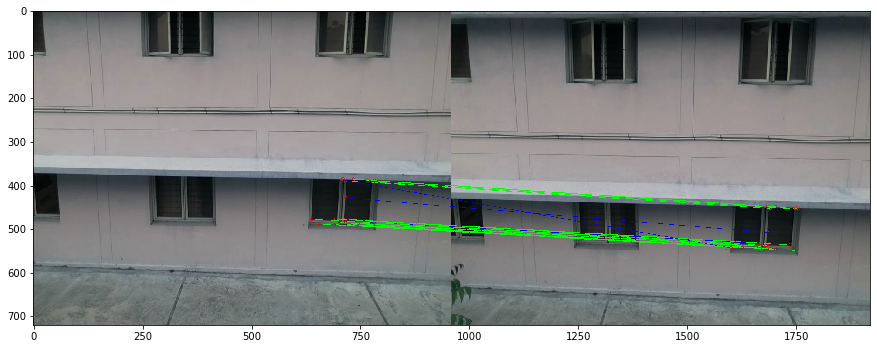

pick1: [[640, 390, 780, 495]]
pick2: [[647, 452, 790, 550]]
box2:  [647, 452, 790, 550]
pointB:  (730, 452)
listA:  []
ElementA:  None
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0


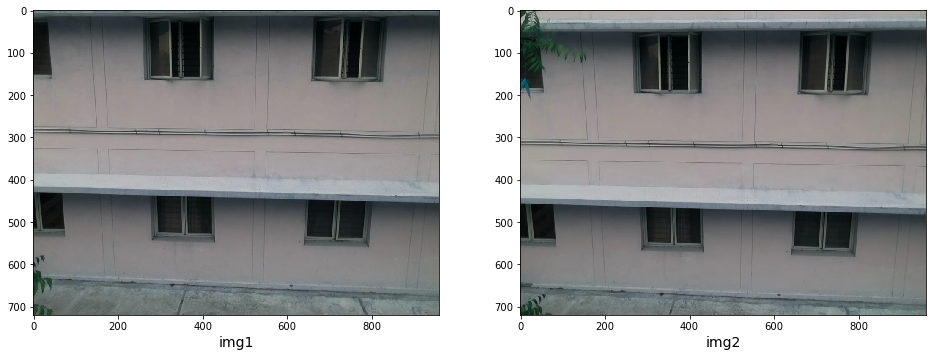

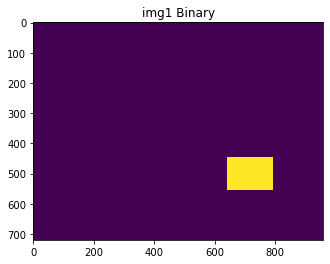

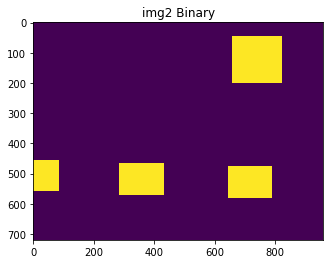

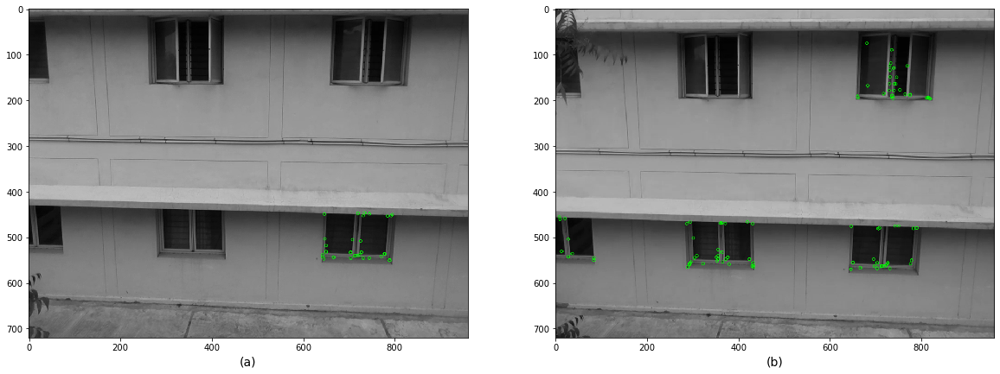

Using: bf feature matcher
Raw matches (Brute force): 33


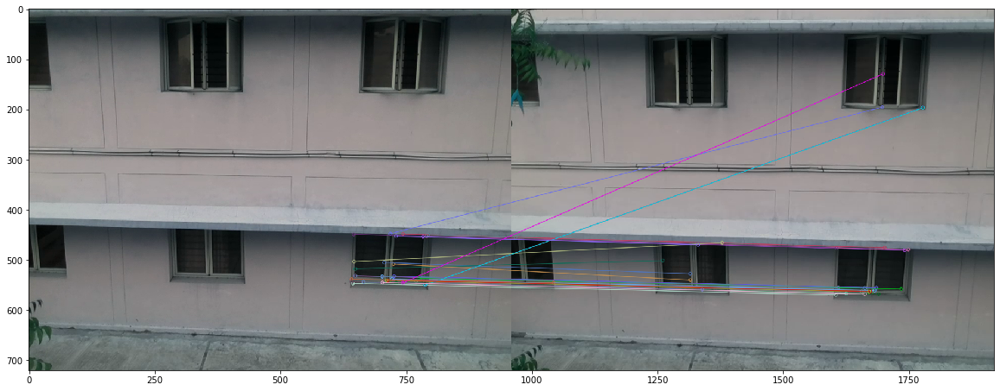

Final homography:  [[ 7.74801234e-01  8.32534411e-02  5.92062705e+01]
 [-8.26029263e-02  9.22986053e-01  7.89838381e+01]
 [-1.77025469e-04  8.76271320e-05  1.00000000e+00]]
Final inliers count:  19
Inliers: [matrix([[783.86785889, 453.42016602, 781.95123291, 480.33126831]]), matrix([[703.07196045, 532.81072998, 702.81665039, 555.72625732]]), matrix([[703.07196045, 532.81072998, 702.81665039, 555.72625732]]), matrix([[730.63580322, 545.05883789, 730.27679443, 567.95227051]]), matrix([[719.06066895, 539.75134277, 718.62402344, 562.9152832 ]]), matrix([[791.16918945, 452.49264526, 789.10827637, 479.41134644]]), matrix([[646.1998291 , 448.8114624 , 646.37164307, 476.00323486]]), matrix([[726.6973877 , 532.28491211, 725.81585693, 555.53320312]]), matrix([[726.6973877 , 532.28491211, 725.81585693, 555.53320312]]), matrix([[744.3157959 , 448.29721069, 741.82965088, 475.22167969]]), matrix([[649.45697021, 531.42468262, 649.65643311, 554.7668457 ]]), matrix([[776.86608887, 535.66131592, 774.982

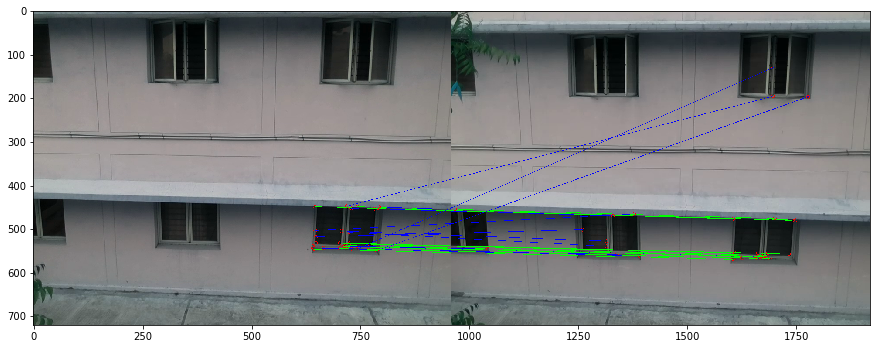

pick1: [[647, 452, 790, 550]]
pick2: [[650, 480, 787, 575], [290, 470, 430, 565], [0, 460, 80, 552], [665, 50, 820, 197]]
box2:  [650, 480, 787, 575]
pointB:  (781, 480)
listA:  []
ElementA:  [647, 452, 790, 550]
count:  0
oldBox
newCountInItr: 0
box2:  [290, 470, 430, 565]
pointB:  (781, 480)
listA:  [[647, 452, 790, 550]]
ElementA:  [647, 452, 790, 550]
count:  1
pointB:  (702, 555)
listA:  [[647, 452, 790, 550]]
ElementA:  [647, 452, 790, 550]
count:  1
pointB:  (702, 555)
listA:  [[647, 452, 790, 550]]
ElementA:  [647, 452, 790, 550]
count:  1
pointB:  (730, 567)
listA:  [[647, 452, 790, 550]]
ElementA:  [647, 452, 790, 550]
count:  1
pointB:  (718, 562)
listA:  [[647, 452, 790, 550]]
ElementA:  [647, 452, 790, 550]
count:  1
pointB:  (789, 479)
listA:  [[647, 452, 790, 550]]
ElementA:  None
count:  0
pointB:  (646, 476)
listA:  [[647, 452, 790, 550]]
ElementA:  None
count:  0
pointB:  (725, 555)
listA:  [[647, 452, 790, 550]]
ElementA:  [647, 452, 790, 550]
count:  1
pointB:  (725

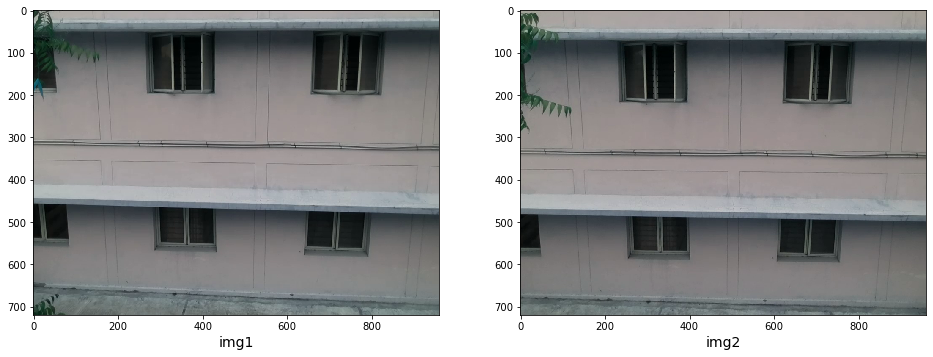

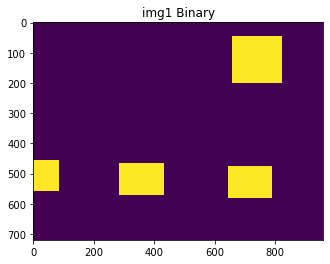

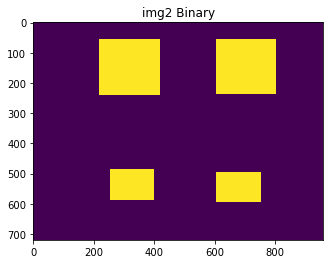

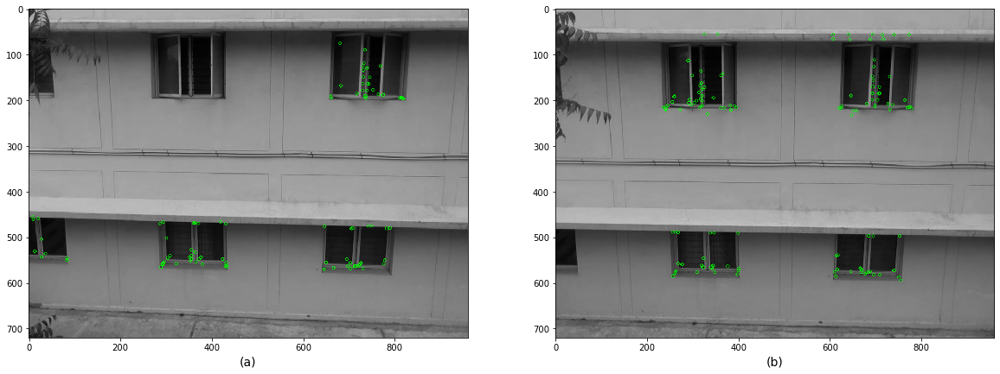

Using: bf feature matcher
Raw matches (Brute force): 76


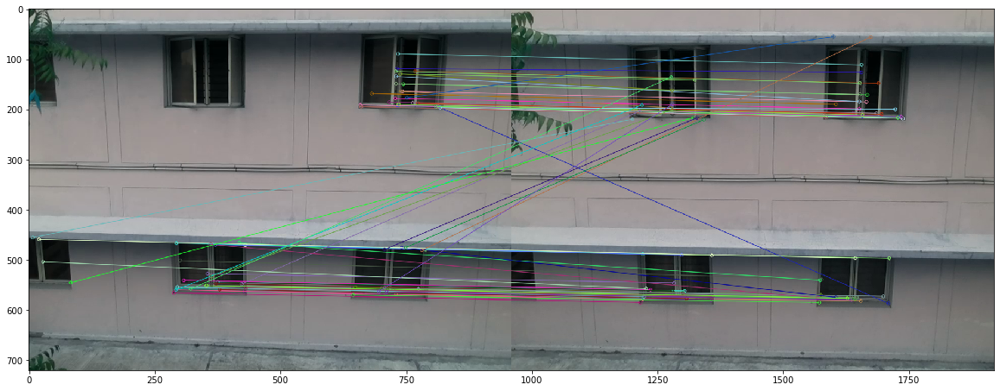

Final homography:  [[ 1.05351522e+00  4.88426837e-03 -5.11281737e+01]
 [ 1.43862378e-02  1.01498677e+00  1.65310902e+01]
 [ 5.17203172e-05 -2.74128381e-07  1.00000000e+00]]
Final inliers count:  50
Inliers: [matrix([[728.85968018, 178.20570374, 691.63311768, 199.14724731]]), matrix([[745.13665771, 149.60110474, 707.37872314, 170.96871948]]), matrix([[288.39550781, 565.13085938, 256.32675171, 584.6817627 ]]), matrix([[375.95922852, 543.83312988, 344.04074097, 561.7532959 ]]), matrix([[375.95922852, 543.83312988, 344.04074097, 561.7532959 ]]), matrix([[429.72103882, 562.3505249 , 397.63458252, 580.46459961]]), matrix([[716.79748535, 185.47132874, 679.85516357, 207.45346069]]), matrix([[730.27679443, 567.95227051, 694.84875488, 581.58074951]]), matrix([[430.62780762, 470.12329102, 398.54620361, 490.69677734]]), matrix([[730.70953369, 149.03453064, 693.05749512, 170.26777649]]), matrix([[354.8493042 , 547.08093262, 322.99639893, 565.45275879]]), matrix([[789.10827637, 479.41134644, 751.474

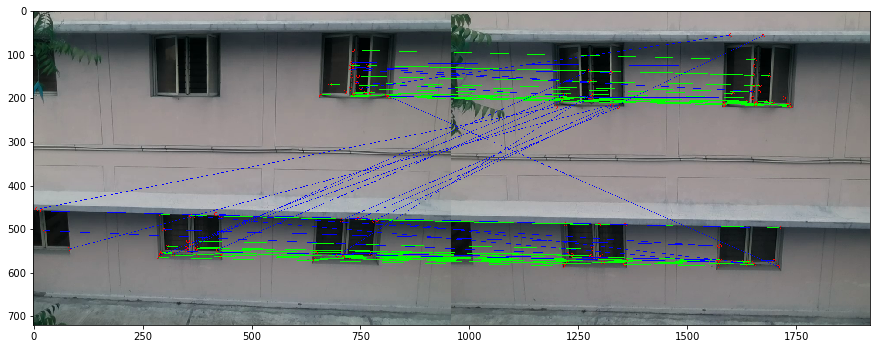

pick1: [[650, 480, 787, 575], [290, 470, 430, 565], [0, 460, 80, 552], [665, 50, 820, 197]]
pick2: [[612, 500, 750, 590], [260, 492, 397, 582], [222, 60, 417, 235], [610, 60, 800, 232]]
box2:  [612, 500, 750, 590]
pointB:  (691, 199)
listA:  []
ElementA:  [665, 50, 820, 197]
count:  0
pointB:  (707, 170)
listA:  []
ElementA:  [665, 50, 820, 197]
count:  0
pointB:  (256, 584)
listA:  []
ElementA:  None
count:  0
pointB:  (344, 561)
listA:  []
ElementA:  [290, 470, 430, 565]
count:  0
pointB:  (344, 561)
listA:  []
ElementA:  [290, 470, 430, 565]
count:  0
pointB:  (397, 580)
listA:  []
ElementA:  [290, 470, 430, 565]
count:  0
pointB:  (679, 207)
listA:  []
ElementA:  [665, 50, 820, 197]
count:  0
pointB:  (694, 581)
listA:  []
ElementA:  [650, 480, 787, 575]
count:  0
oldBox
newCountInItr: 0
box2:  [260, 492, 397, 582]
pointB:  (691, 199)
listA:  [[650, 480, 787, 575]]
ElementA:  [665, 50, 820, 197]
count:  0
pointB:  (707, 170)
listA:  [[650, 480, 787, 575]]
ElementA:  [665, 50, 820, 

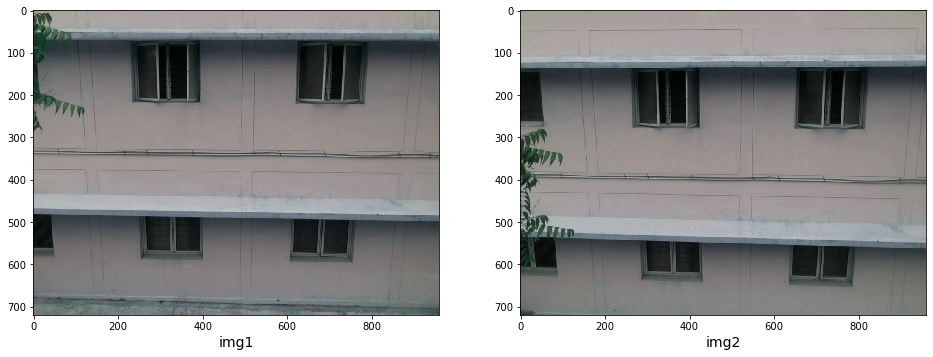

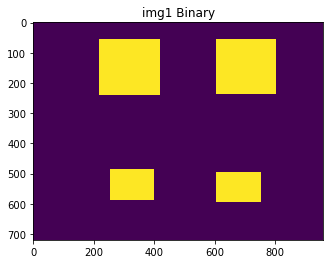

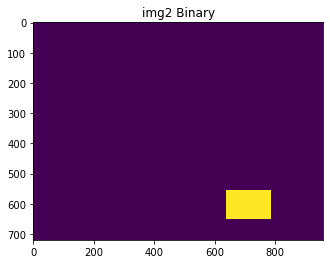

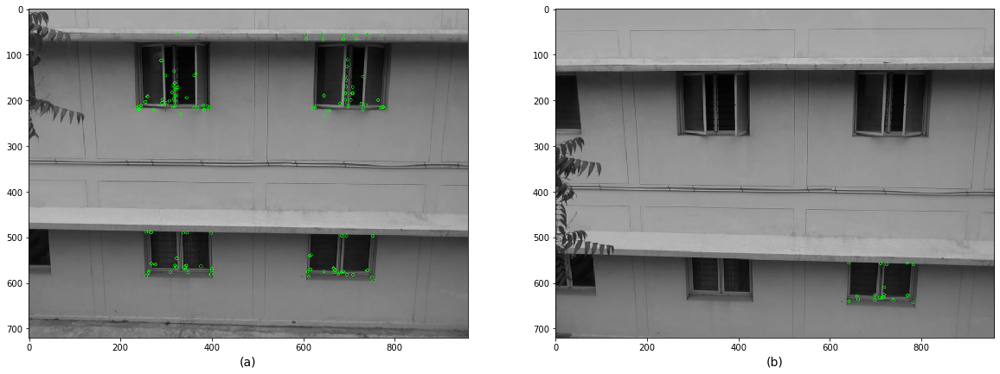

Using: bf feature matcher
Raw matches (Brute force): 21


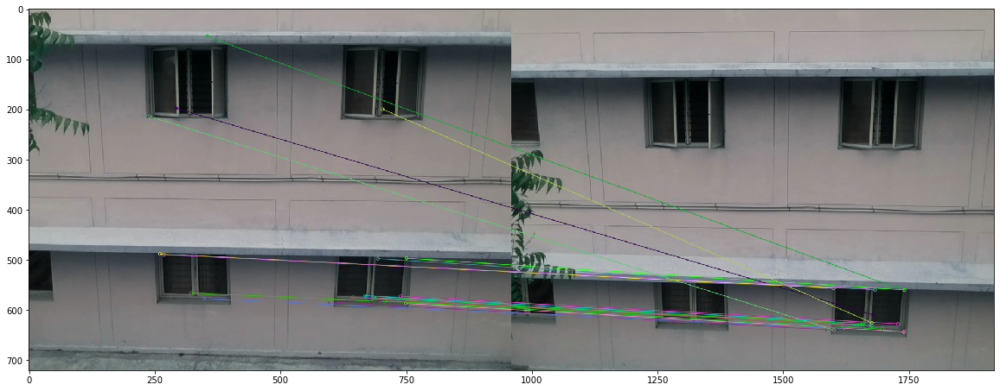

Final homography:  [[ 1.91002966e+00  5.17380619e-01 -4.28380363e+02]
 [ 2.27318902e-01  1.90019558e+00 -2.09554548e+02]
 [ 3.60603700e-04  6.96609742e-04  1.00000000e+00]]
Final inliers count:  12
Inliers: [matrix([[749.79956055, 586.35955811, 780.60015869, 642.60516357]]), matrix([[612.17126465, 584.67926025, 640.88336182, 639.17694092]]), matrix([[694.0980835 , 497.32382202, 723.14648438, 559.4163208 ]]), matrix([[751.47454834, 496.5300293 , 781.66558838, 559.58288574]]), matrix([[678.37359619, 576.62091064, 707.83770752, 631.69659424]]), matrix([[683.40753174, 576.86920166, 712.85827637, 632.33349609]]), matrix([[686.84051514, 574.77148438, 716.52416992, 630.28656006]]), matrix([[707.94824219, 581.59155273, 737.57531738, 637.21917725]]), matrix([[686.84051514, 574.77148438, 716.52416992, 630.28656006]]), matrix([[739.44549561, 572.20465088, 768.69232178, 626.87298584]]), matrix([[669.02081299, 571.05334473, 697.85162354, 625.62854004]]), matrix([[739.44549561, 572.20465088, 768.692

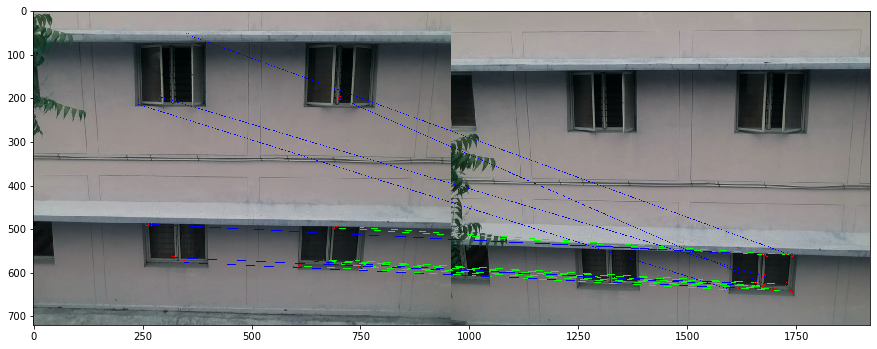

pick1: [[612, 500, 750, 590], [260, 492, 397, 582], [222, 60, 417, 235], [610, 60, 800, 232]]
pick2: [[645, 560, 782, 647]]
box2:  [645, 560, 782, 647]
pointB:  (780, 642)
listA:  []
ElementA:  [612, 500, 750, 590]
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0


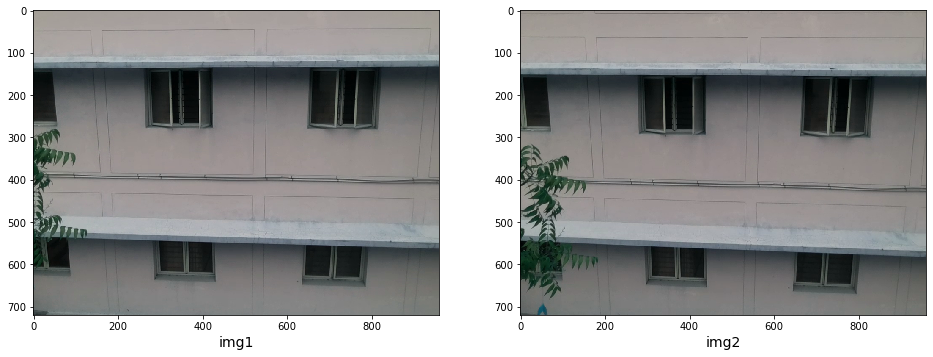

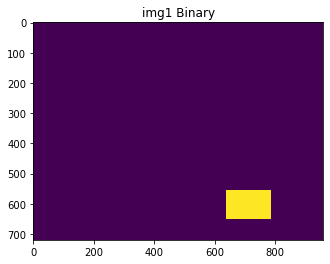

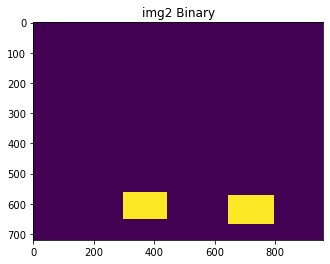

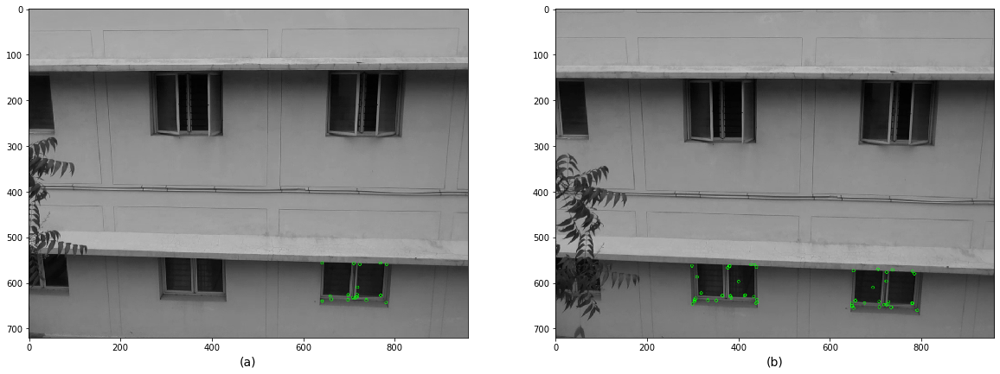

Using: bf feature matcher
Raw matches (Brute force): 20


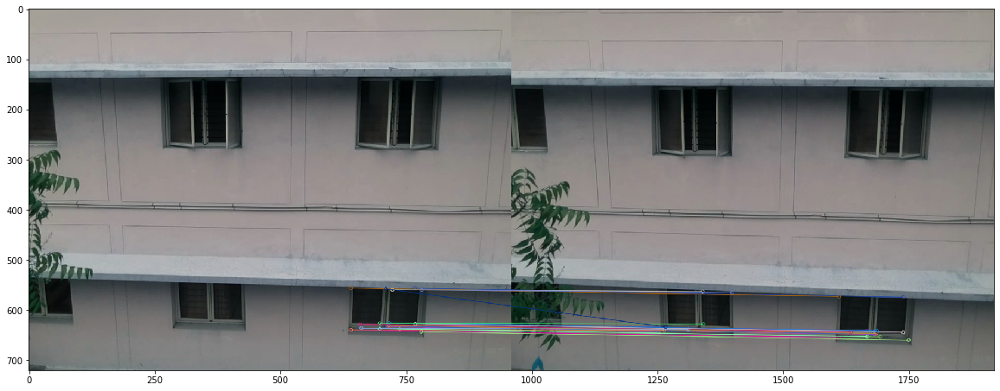

Final homography:  [[ 7.57367433e-01  5.99319363e-02  7.55361980e+01]
 [-1.43625185e-01  9.62687509e-01  7.95366899e+01]
 [-2.24991930e-04  1.02002809e-04  1.00000000e+00]]
Final inliers count:  12
Inliers: [matrix([[640.88336182, 639.17694092, 650.62402344, 654.52178955]]), matrix([[780.60015869, 642.60516357, 789.90063477, 659.38671875]]), matrix([[712.85827637, 632.33349609, 722.53619385, 647.95355225]]), matrix([[707.83770752, 631.69659424, 717.55169678, 647.3717041 ]]), matrix([[716.52416992, 630.28656006, 726.07098389, 646.159729  ]]), matrix([[767.68634033, 555.94262695, 779.21972656, 574.06561279]]), matrix([[697.85162354, 625.62854004, 706.70361328, 640.39337158]]), matrix([[768.69232178, 626.87298584, 778.90045166, 643.85754395]]), matrix([[768.69232178, 626.87298584, 778.90045166, 643.85754395]]), matrix([[717.15576172, 625.07165527, 727.11090088, 640.82519531]]), matrix([[640.60241699, 555.83477783, 650.93334961, 572.69836426]]), matrix([[697.56054688, 636.69128418, 707.053

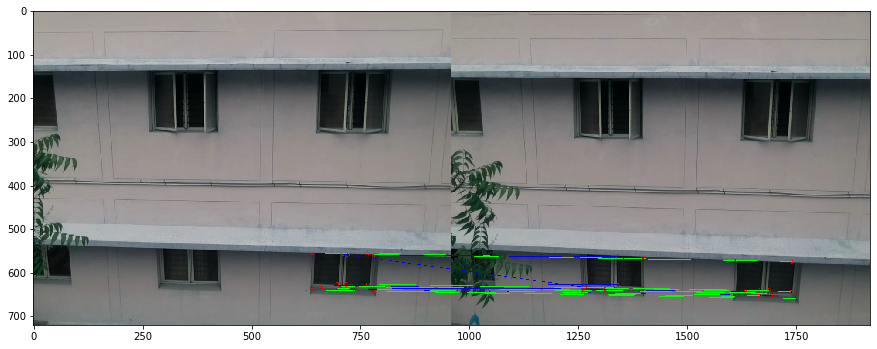

pick1: [[645, 560, 782, 647]]
pick2: [[652, 575, 792, 662], [302, 565, 437, 647]]
box2:  [652, 575, 792, 662]
pointB:  (650, 654)
listA:  []
ElementA:  None
count:  0
pointB:  (789, 659)
listA:  []
ElementA:  [645, 560, 782, 647]
count:  0
oldBox
newCountInItr: 0
box2:  [302, 565, 437, 647]
pointB:  (650, 654)
listA:  [[645, 560, 782, 647]]
ElementA:  None
count:  0
pointB:  (789, 659)
listA:  [[645, 560, 782, 647]]
ElementA:  [645, 560, 782, 647]
count:  1
pointB:  (722, 647)
listA:  [[645, 560, 782, 647]]
ElementA:  [645, 560, 782, 647]
count:  1
pointB:  (717, 647)
listA:  [[645, 560, 782, 647]]
ElementA:  [645, 560, 782, 647]
count:  1
pointB:  (726, 646)
listA:  [[645, 560, 782, 647]]
ElementA:  [645, 560, 782, 647]
count:  1
pointB:  (779, 574)
listA:  [[645, 560, 782, 647]]
ElementA:  None
count:  0
pointB:  (706, 640)
listA:  [[645, 560, 782, 647]]
ElementA:  [645, 560, 782, 647]
count:  1
pointB:  (778, 643)
listA:  [[645, 560, 782, 647]]
ElementA:  [645, 560, 782, 647]
count:

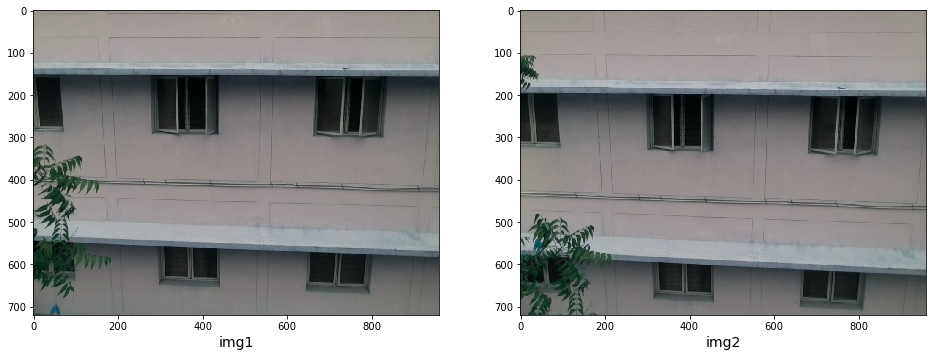

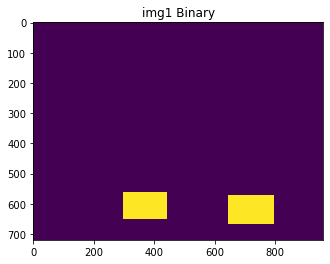

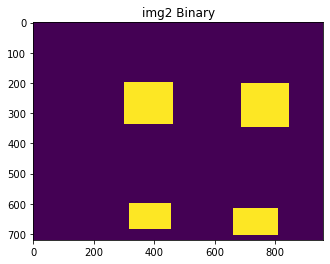

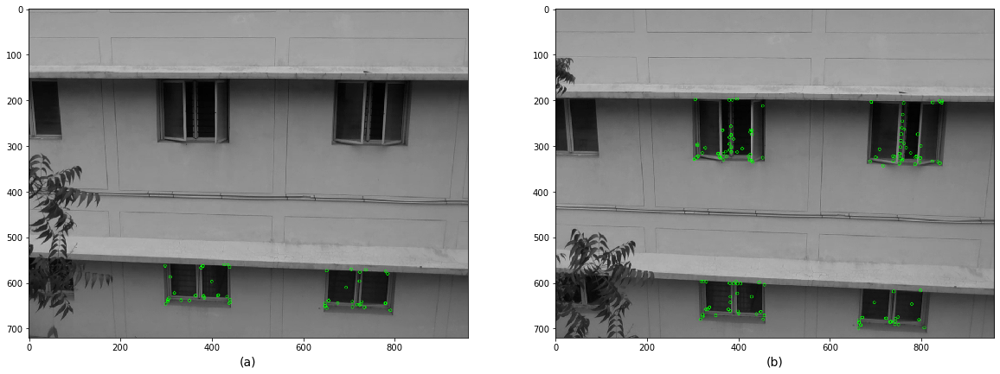

Using: bf feature matcher
Raw matches (Brute force): 47


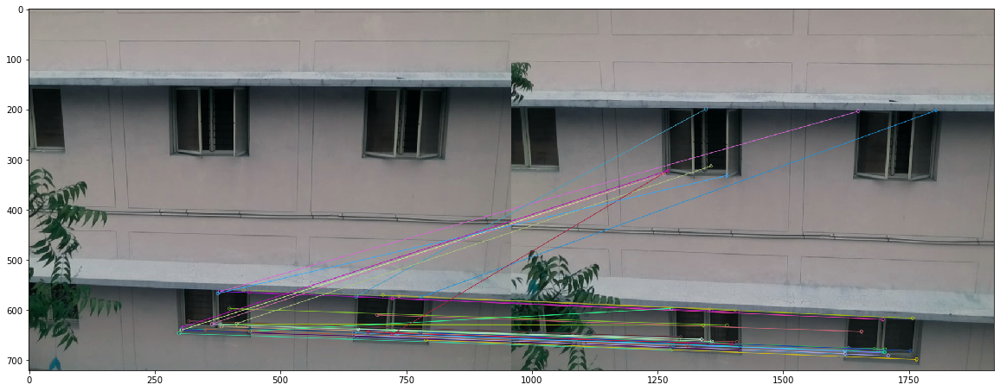

Final homography:  [[1.02968320e+00 3.58152246e-03 1.35540288e+01]
 [1.70207313e-02 9.80749614e-01 5.75843408e+01]
 [8.44855414e-06 3.76965758e-05 1.00000000e+00]]
Final inliers count:  28
Inliers: [matrix([[303.57296753, 639.63720703, 321.46420288, 673.15142822]]), matrix([[427.05999756, 559.83013916, 444.59033203, 598.87139893]]), matrix([[299.04666138, 645.96044922, 316.74707031, 679.43688965]]), matrix([[723.09289551, 576.25585938, 738.61083984, 618.17211914]]), matrix([[379.98129272, 562.57037354, 397.13235474, 601.11499023]]), matrix([[733.42108154, 652.9855957 , 749.30010986, 690.51947021]]), matrix([[303.9203186 , 636.39929199, 321.33843994, 669.425354  ]]), matrix([[364.43685913, 627.73382568, 381.34521484, 661.17346191]]), matrix([[383.48269653, 632.08660889, 399.86038208, 666.00323486]]), matrix([[648.1237793 , 650.43713379, 663.92193604, 686.94281006]]), matrix([[647.15203857, 649.60693359, 663.09320068, 686.14648438]]), matrix([[650.62402344, 654.52178955, 666.67523193, 69

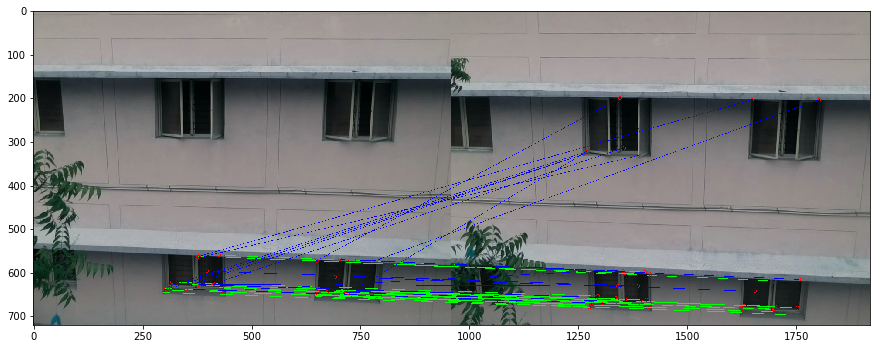

pick1: [[652, 575, 792, 662], [302, 565, 437, 647]]
pick2: [[667, 620, 807, 697], [322, 602, 452, 680], [692, 207, 842, 342], [305, 202, 457, 332]]
box2:  [667, 620, 807, 697]
pointB:  (321, 673)
listA:  []
ElementA:  [302, 565, 437, 647]
count:  0
pointB:  (444, 598)
listA:  []
ElementA:  None
count:  0
pointB:  (316, 679)
listA:  []
ElementA:  None
count:  0
pointB:  (738, 618)
listA:  []
ElementA:  [652, 575, 792, 662]
count:  0
pointB:  (397, 601)
listA:  []
ElementA:  None
count:  0
pointB:  (749, 690)
listA:  []
ElementA:  [652, 575, 792, 662]
count:  0
oldBox
newCountInItr: 0
box2:  [322, 602, 452, 680]
pointB:  (321, 673)
listA:  [[652, 575, 792, 662]]
ElementA:  [302, 565, 437, 647]
count:  0
pointB:  (444, 598)
listA:  [[652, 575, 792, 662]]
ElementA:  None
count:  0
pointB:  (316, 679)
listA:  [[652, 575, 792, 662]]
ElementA:  None
count:  0
pointB:  (738, 618)
listA:  [[652, 575, 792, 662]]
ElementA:  [652, 575, 792, 662]
count:  1
pointB:  (397, 601)
listA:  [[652, 575, 79

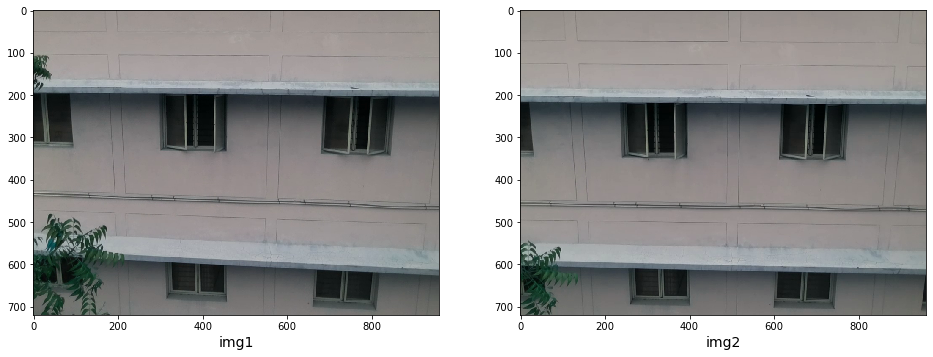

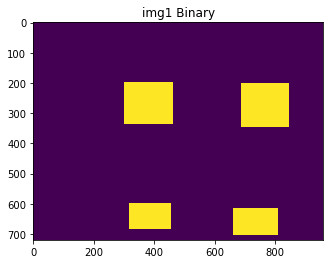

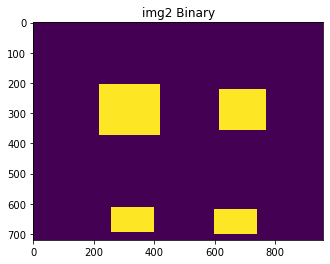

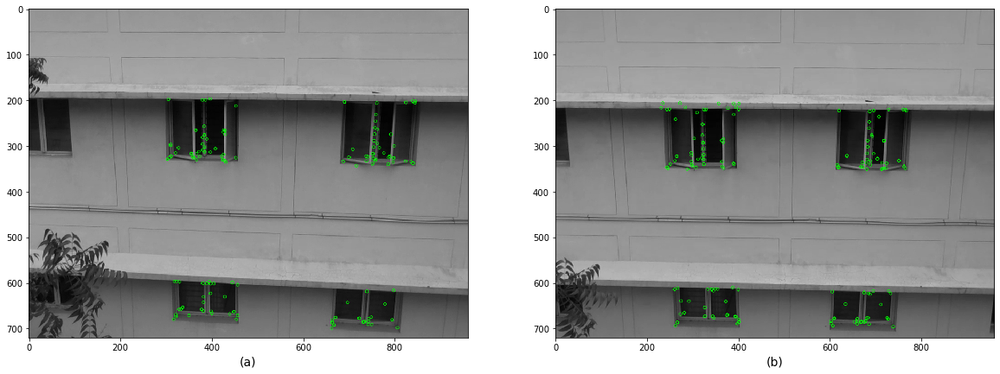

Using: bf feature matcher
Raw matches (Brute force): 110


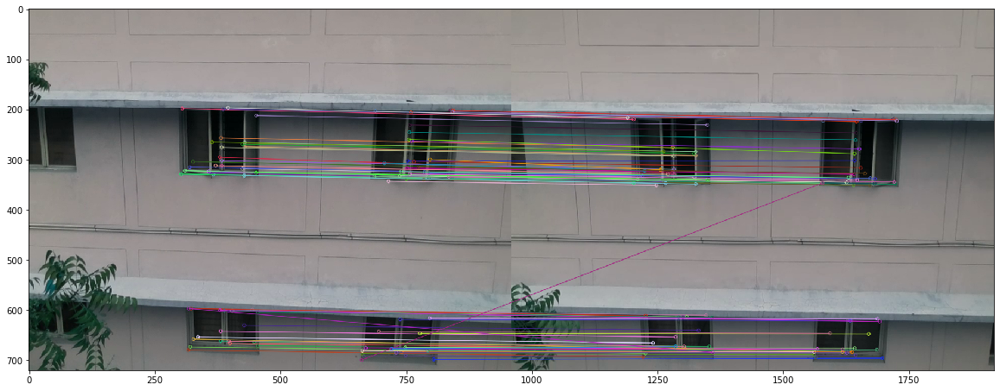

Final homography:  [[ 1.01074834e+00  2.21971982e-02 -6.76648828e+01]
 [-9.40694259e-03  1.00356106e+00  2.43154334e+01]
 [ 2.92136530e-05  1.12855684e-05  1.00000000e+00]]
Final inliers count:  83
Inliers: [matrix([[797.31854248, 615.94036865, 728.02905273, 617.09613037]]), matrix([[453.52767944, 679.40808105, 397.29257202, 688.43133545]]), matrix([[428.97323608, 266.02871704, 366.33288574, 284.31997681]]), matrix([[428.94238281, 274.1008606 , 366.36660767, 292.090271  ]]), matrix([[425.22546387, 269.52786255, 363.12667847, 288.04907227]]), matrix([[383.65734863, 275.7454834 , 322.22436523, 292.75177002]]), matrix([[364.63916016, 265.3508606 , 302.94070435, 283.47219849]]), matrix([[444.59033203, 598.87139893, 386.74716187, 609.80987549]]), matrix([[303.23553467, 328.80435181, 243.12867737, 346.28430176]]), matrix([[749.30010986, 690.51947021, 684.8336792 , 689.68591309]]), matrix([[670.06072998, 675.01489258, 608.57952881, 677.2947998 ]]), matrix([[383.7868042 , 312.54000854, 323.151

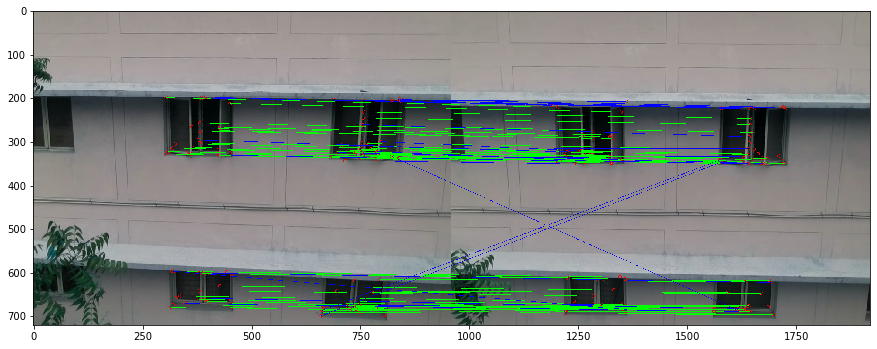

pick1: [[667, 620, 807, 697], [322, 602, 452, 680], [692, 207, 842, 342], [305, 202, 457, 332]]
pick2: [[605, 622, 737, 695], [262, 615, 397, 690], [225, 210, 415, 367], [620, 225, 767, 352]]
box2:  [605, 622, 737, 695]
pointB:  (728, 617)
listA:  []
ElementA:  None
count:  0
pointB:  (397, 688)
listA:  []
ElementA:  None
count:  0
pointB:  (366, 284)
listA:  []
ElementA:  [305, 202, 457, 332]
count:  0
pointB:  (366, 292)
listA:  []
ElementA:  [305, 202, 457, 332]
count:  0
pointB:  (363, 288)
listA:  []
ElementA:  [305, 202, 457, 332]
count:  0
pointB:  (322, 292)
listA:  []
ElementA:  [305, 202, 457, 332]
count:  0
pointB:  (302, 283)
listA:  []
ElementA:  [305, 202, 457, 332]
count:  0
pointB:  (386, 609)
listA:  []
ElementA:  None
count:  0
pointB:  (243, 346)
listA:  []
ElementA:  None
count:  0
pointB:  (684, 689)
listA:  []
ElementA:  [667, 620, 807, 697]
count:  0
oldBox
newCountInItr: 0
box2:  [262, 615, 397, 690]
pointB:  (728, 617)
listA:  [[667, 620, 807, 697]]
ElementA:  

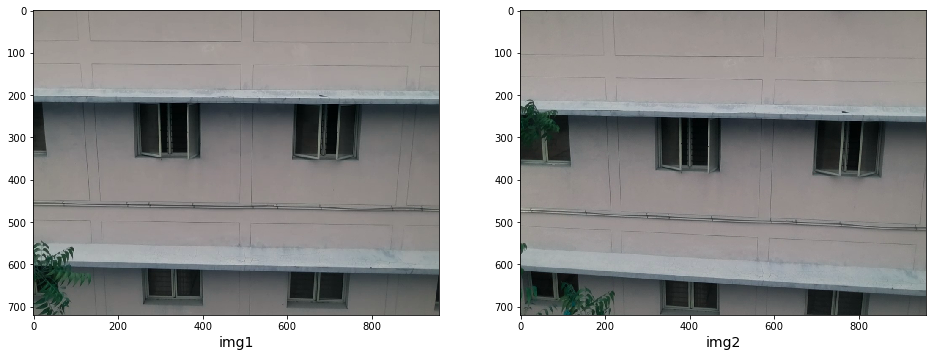

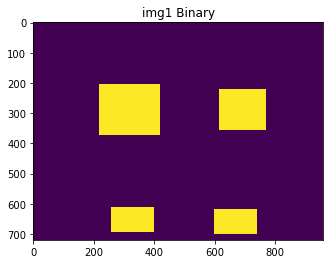

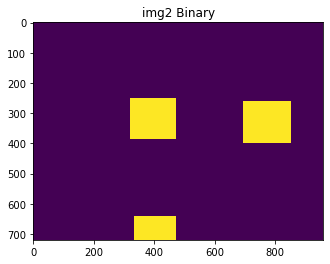

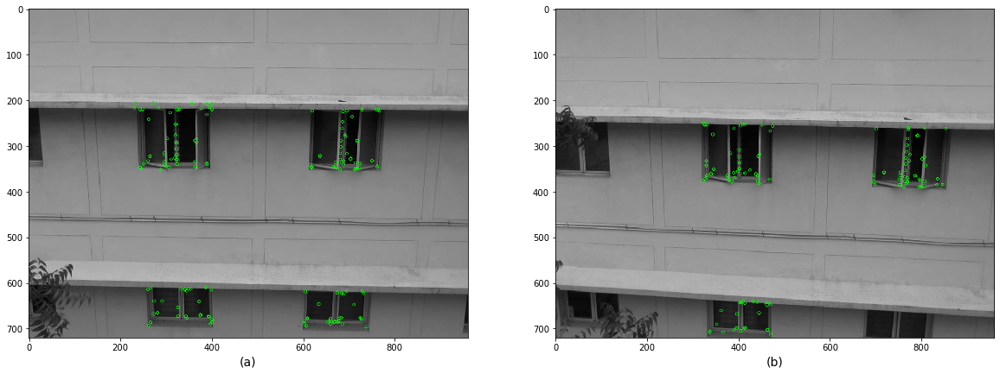

Using: bf feature matcher
Raw matches (Brute force): 95


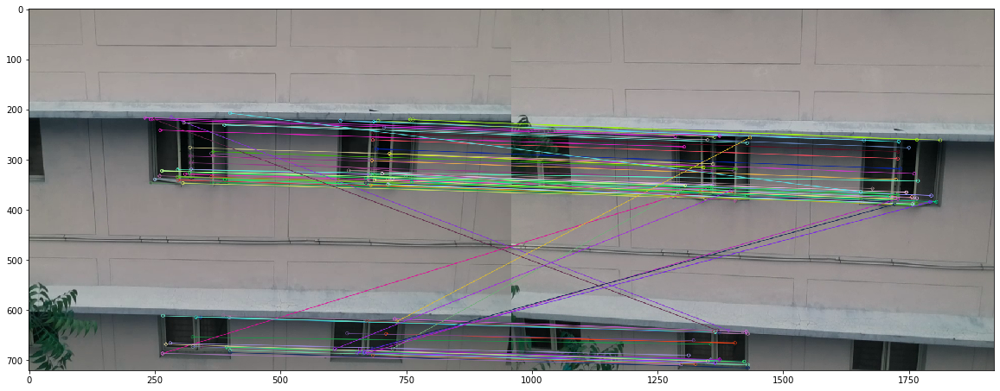

Final homography:  [[ 9.44667444e-01 -2.17353141e-02  9.62998393e+01]
 [-7.45654928e-03  9.74827117e-01  3.72109379e+01]
 [-5.93560982e-05  3.94603396e-06  1.00000000e+00]]
Final inliers count:  67
Inliers: [matrix([[717.05554199, 288.449646  , 800.97442627, 328.05450439]]), matrix([[261.53778076, 241.47724915, 343.4133606 , 274.70108032]]), matrix([[706.24121094, 236.01219177, 790.35113525, 276.49853516]]), matrix([[323.17276001, 319.24612427, 401.30001831, 349.4175415 ]]), matrix([[323.17276001, 319.24612427, 401.30001831, 349.4175415 ]]), matrix([[389.16207886, 231.03771973, 468.69161987, 266.73626709]]), matrix([[750.06262207, 332.22253418, 834.54211426, 371.66278076]]), matrix([[363.12667847, 288.04907227, 442.52944946, 321.81964111]]), matrix([[398.94726562, 614.31787109, 469.80606079, 646.83898926]]), matrix([[686.40979004, 224.30116272, 770.26153564, 264.38131714]]), matrix([[713.63189697, 337.01654053, 795.84576416, 374.7550354 ]]), matrix([[243.12867737, 346.28430176, 322.370

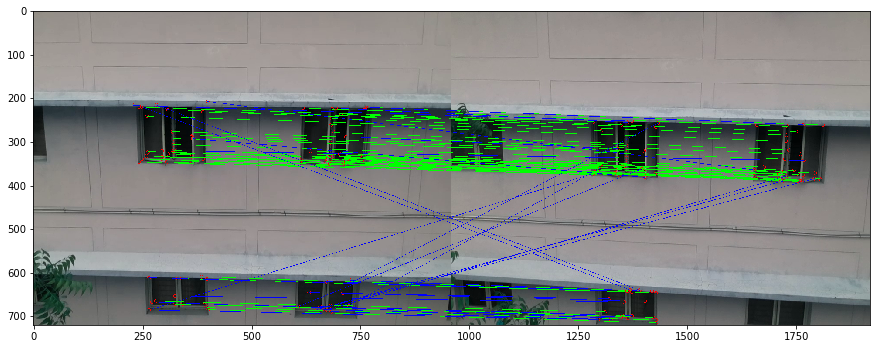

pick1: [[605, 622, 737, 695], [262, 615, 397, 690], [225, 210, 415, 367], [620, 225, 767, 352]]
pick2: [[340, 645, 467, 715], [700, 265, 850, 395], [325, 255, 470, 380]]
box2:  [340, 645, 467, 715]
pointB:  (800, 328)
listA:  []
ElementA:  [620, 225, 767, 352]
count:  0
pointB:  (343, 274)
listA:  []
ElementA:  [225, 210, 415, 367]
count:  0
pointB:  (790, 276)
listA:  []
ElementA:  [620, 225, 767, 352]
count:  0
pointB:  (401, 349)
listA:  []
ElementA:  [225, 210, 415, 367]
count:  0
pointB:  (401, 349)
listA:  []
ElementA:  [225, 210, 415, 367]
count:  0
pointB:  (468, 266)
listA:  []
ElementA:  [225, 210, 415, 367]
count:  0
pointB:  (834, 371)
listA:  []
ElementA:  [620, 225, 767, 352]
count:  0
pointB:  (442, 321)
listA:  []
ElementA:  [225, 210, 415, 367]
count:  0
pointB:  (469, 646)
listA:  []
ElementA:  None
count:  0
pointB:  (770, 264)
listA:  []
ElementA:  None
count:  0
pointB:  (795, 374)
listA:  []
ElementA:  [620, 225, 767, 352]
count:  0
pointB:  (322, 375)
listA:  []


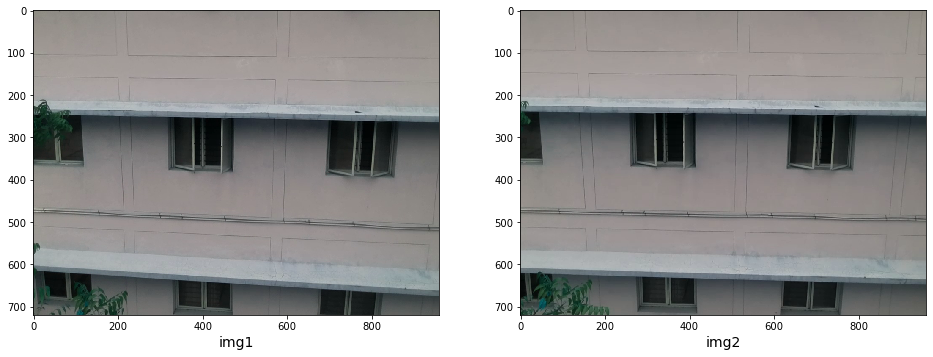

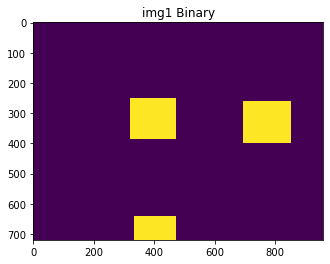

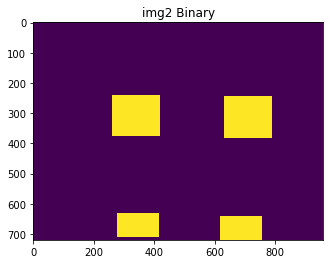

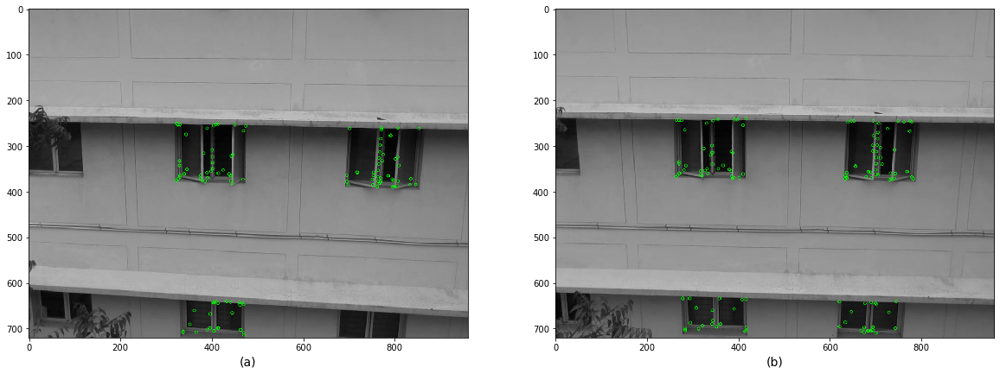

Using: bf feature matcher
Raw matches (Brute force): 94


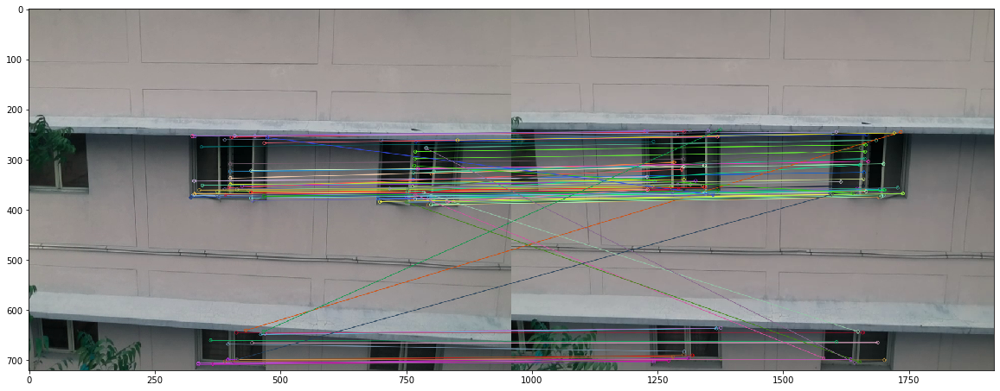

Final homography:  [[ 1.02349011e+00  4.79848727e-02 -7.43326233e+01]
 [-9.58177121e-03  1.06578952e+00 -1.80437209e+01]
 [ 1.32502377e-05  7.43892797e-05  1.00000000e+00]]
Final inliers count:  61
Inliers: [matrix([[437.54364014, 361.40896606, 379.60888672, 351.48974609]]), matrix([[764.68127441, 339.66070557, 700.81848145, 325.39120483]]), matrix([[763.61694336, 353.54452515, 700.02746582, 338.6696167 ]]), matrix([[414.27410889, 359.52944946, 355.878479  , 349.70303345]]), matrix([[442.52944946, 321.81964111, 383.94976807, 311.53665161]]), matrix([[329.02905273, 342.81564331, 269.55792236, 334.37805176]]), matrix([[794.07824707, 390.45166016, 729.82763672, 374.2230835 ]]), matrix([[750.69696045, 373.06759644, 687.92999268, 357.73556519]]), matrix([[437.54364014, 361.40896606, 379.60888672, 351.48974609]]), matrix([[389.63656616, 260.74057007, 329.72451782, 250.18701172]]), matrix([[343.4133606 , 274.70108032, 282.20910645, 264.35723877]]), matrix([[762.65722656, 367.16186523, 699.159

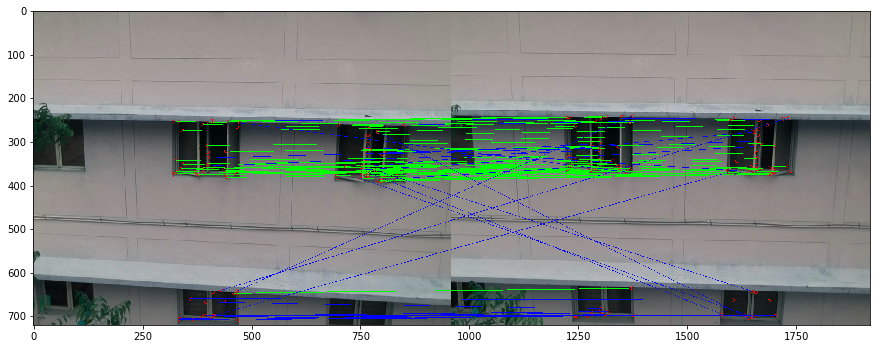

pick1: [[340, 645, 467, 715], [700, 265, 850, 395], [325, 255, 470, 380]]
pick2: [[625, 645, 752, 715], [282, 637, 412, 705], [637, 250, 787, 377], [265, 245, 415, 370]]
box2:  [625, 645, 752, 715]
pointB:  (379, 351)
listA:  []
ElementA:  [325, 255, 470, 380]
count:  0
pointB:  (700, 325)
listA:  []
ElementA:  [700, 265, 850, 395]
count:  0
pointB:  (700, 338)
listA:  []
ElementA:  [700, 265, 850, 395]
count:  0
pointB:  (355, 349)
listA:  []
ElementA:  [325, 255, 470, 380]
count:  0
pointB:  (383, 311)
listA:  []
ElementA:  [325, 255, 470, 380]
count:  0
pointB:  (269, 334)
listA:  []
ElementA:  [325, 255, 470, 380]
count:  0
pointB:  (729, 374)
listA:  []
ElementA:  [700, 265, 850, 395]
count:  0
pointB:  (687, 357)
listA:  []
ElementA:  [700, 265, 850, 395]
count:  0
pointB:  (379, 351)
listA:  []
ElementA:  [325, 255, 470, 380]
count:  0
pointB:  (329, 250)
listA:  []
ElementA:  [325, 255, 470, 380]
count:  0
pointB:  (282, 264)
listA:  []
ElementA:  [325, 255, 470, 380]
count:  0

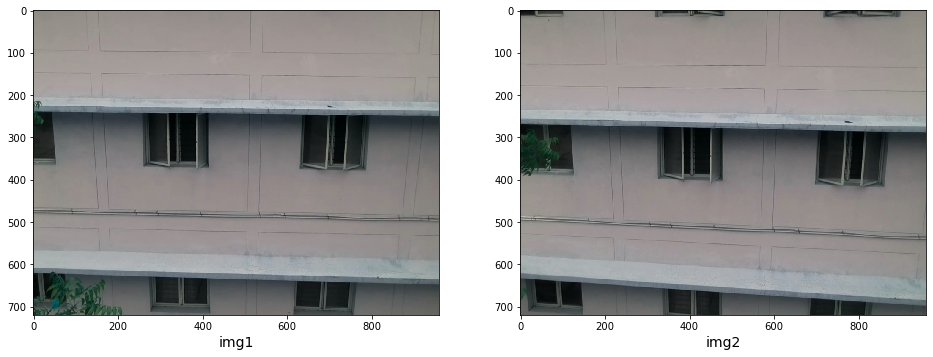

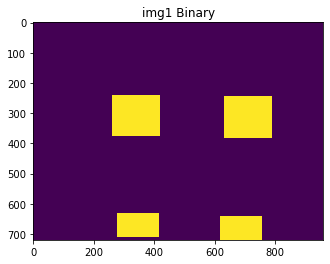

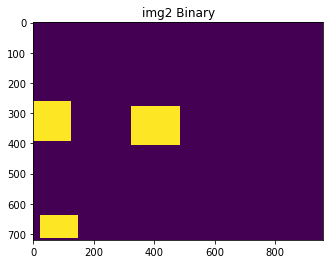

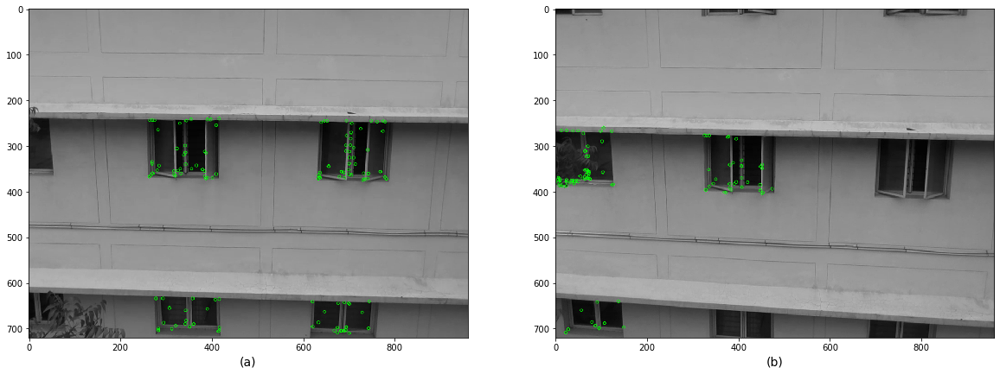

Using: bf feature matcher
Raw matches (Brute force): 76


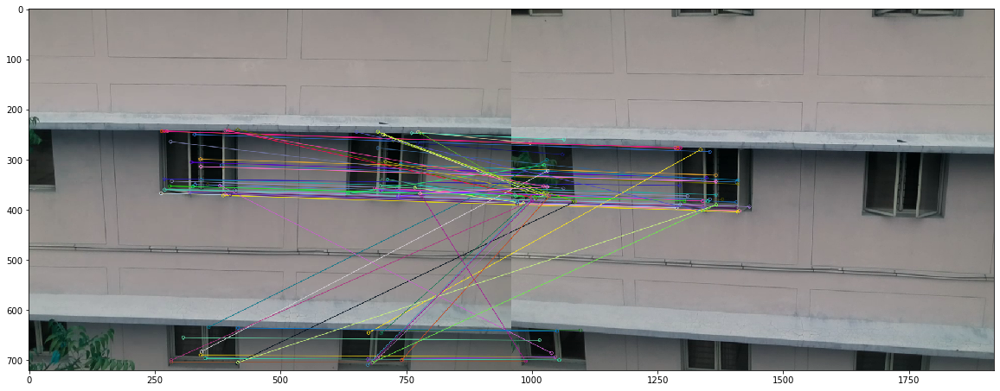

Final homography:  [[ 1.16371285e+00 -1.48305158e-01  6.10941602e+01]
 [ 1.64316158e-01  8.59788349e-01  2.43959309e+01]
 [ 3.68704251e-04 -3.55042365e-04  1.00000000e+00]]
Final inliers count:  24
Inliers: [matrix([[329.72451782, 250.18701172, 394.76855469, 284.37145996]]), matrix([[355.878479  , 349.70303345, 419.69921875, 379.44042969]]), matrix([[323.60430908, 305.46325684, 388.18392944, 336.86315918]]), matrix([[383.94976807, 311.53665161, 447.83609009, 344.67129517]]), matrix([[342.68551636, 340.03460693, 406.88314819, 369.8963623 ]]), matrix([[342.11416626, 314.07580566, 406.57922363, 343.76846313]]), matrix([[263.23440552, 367.0880127 , 328.18374634, 395.95437622]]), matrix([[330.87969971, 349.53768921, 394.82751465, 379.0791626 ]]), matrix([[341.48706055, 299.07492065, 406.54870605, 330.9102478 ]]), matrix([[326.26272583, 353.81494141, 390.25067139, 383.02575684]]), matrix([[263.23440552, 367.0880127 , 328.18374634, 395.95437622]]), matrix([[264.42541504, 243.53726196, 330.439

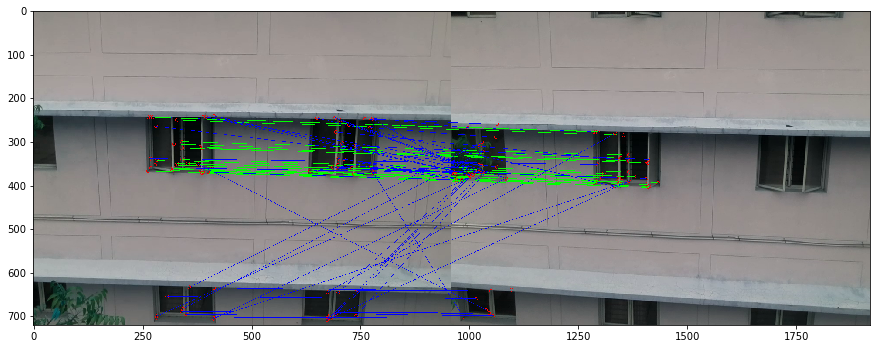

pick1: [[625, 645, 752, 715], [282, 637, 412, 705], [637, 250, 787, 377], [265, 245, 415, 370]]
pick2: [[27, 642, 145, 710], [330, 282, 480, 400], [0, 265, 122, 387]]
box2:  [27, 642, 145, 710]
pointB:  (394, 284)
listA:  []
ElementA:  [265, 245, 415, 370]
count:  0
pointB:  (419, 379)
listA:  []
ElementA:  [265, 245, 415, 370]
count:  0
pointB:  (388, 336)
listA:  []
ElementA:  [265, 245, 415, 370]
count:  0
pointB:  (447, 344)
listA:  []
ElementA:  [265, 245, 415, 370]
count:  0
pointB:  (406, 369)
listA:  []
ElementA:  [265, 245, 415, 370]
count:  0
pointB:  (406, 343)
listA:  []
ElementA:  [265, 245, 415, 370]
count:  0
pointB:  (328, 395)
listA:  []
ElementA:  None
count:  0
pointB:  (394, 379)
listA:  []
ElementA:  [265, 245, 415, 370]
count:  0
pointB:  (406, 330)
listA:  []
ElementA:  [265, 245, 415, 370]
count:  0
pointB:  (390, 383)
listA:  []
ElementA:  [265, 245, 415, 370]
count:  0
pointB:  (328, 395)
listA:  []
ElementA:  None
count:  0
pointB:  (330, 277)
listA:  []
Elem

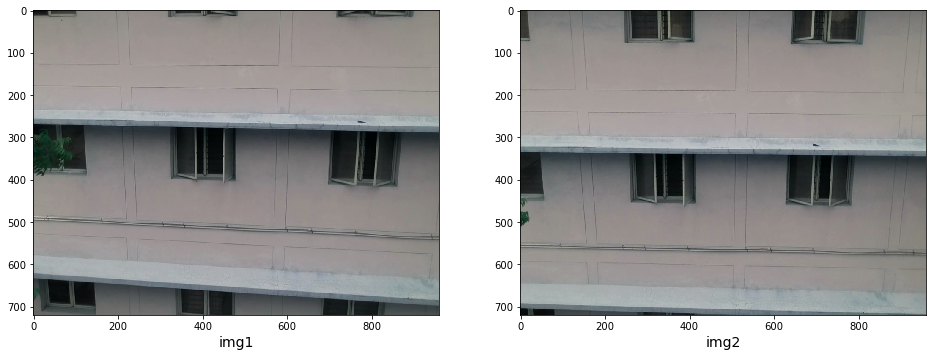

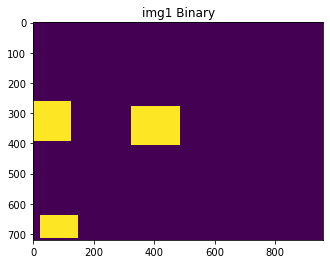

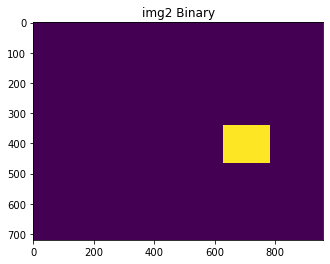

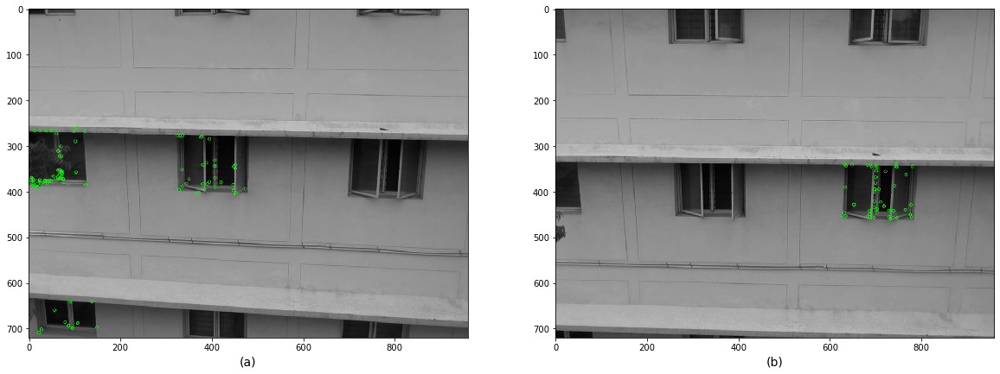

Using: bf feature matcher
Raw matches (Brute force): 35


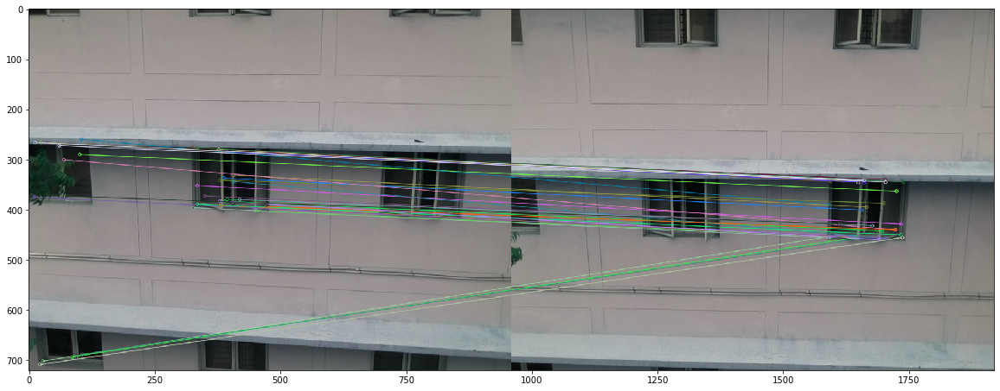

Final homography:  [[ 2.17586562e+00 -1.19043317e+00  7.50271748e+02]
 [ 1.45108115e+00 -5.41564255e-01  3.25255148e+02]
 [ 3.07872803e-03 -1.58945353e-03  1.00000000e+00]]
Final inliers count:  7
Inliers: [matrix([[ 37.1699791 , 267.08560181, 743.86010742, 339.96566772]]), matrix([[ 22.3943634 , 708.05859375, 777.22210693, 455.17001343]]), matrix([[ 22.3943634 , 708.05859375, 777.22210693, 455.17001343]]), matrix([[394.82751465, 379.0791626 , 717.43988037, 431.47750854]]), matrix([[ 86.79386902, 692.82977295, 685.54943848, 454.89584351]]), matrix([[419.69921875, 379.44042969, 717.43988037, 431.47750854]]), matrix([[106.5437088 , 687.62817383, 695.63909912, 457.16455078]])]
(720, 960, 3)
(720, 960, 3)
(720, 960, 9)


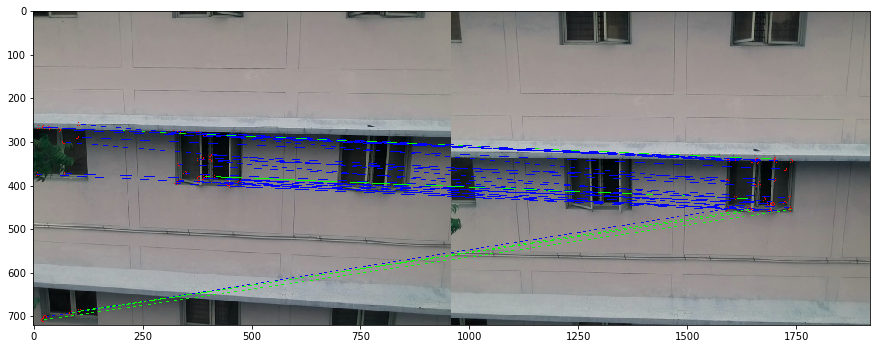

pick1: [[27, 642, 145, 710], [330, 282, 480, 400], [0, 265, 122, 387]]
pick2: [[635, 345, 780, 460]]
box2:  [635, 345, 780, 460]
pointB:  (743, 339)
listA:  []
ElementA:  [0, 265, 122, 387]
count:  0
pointB:  (777, 455)
listA:  []
ElementA:  None
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0


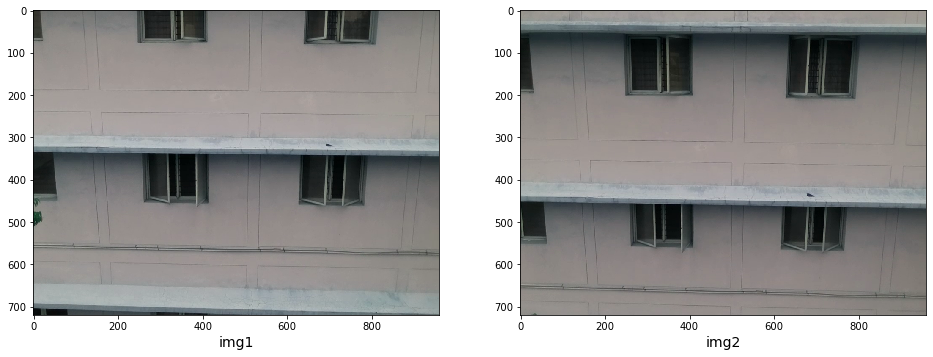

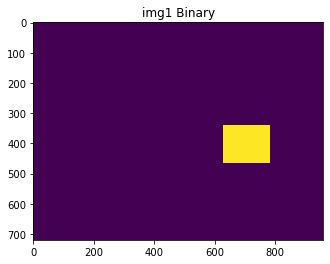

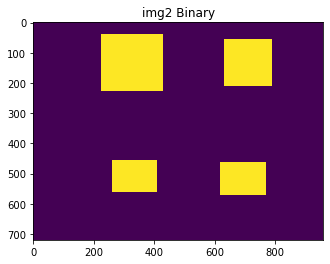

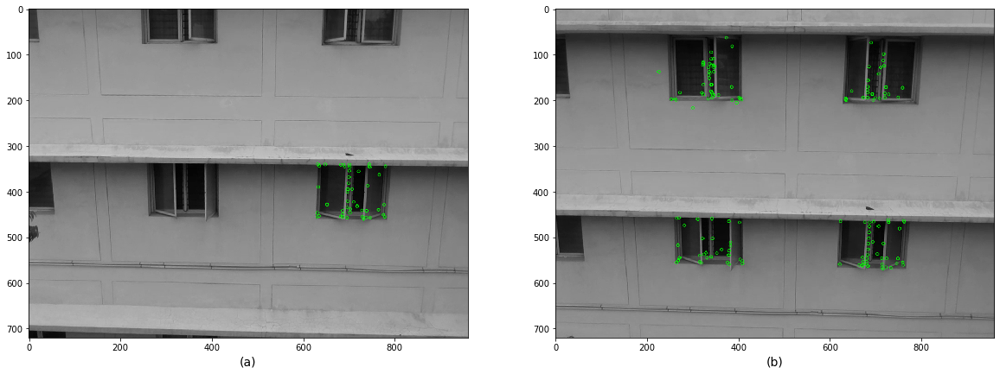

Using: bf feature matcher
Raw matches (Brute force): 51


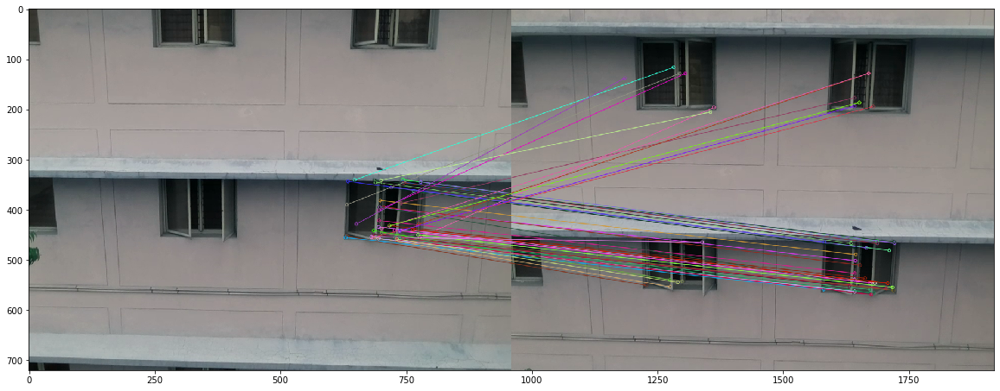

Final homography:  [[ 7.68011028e-01  2.16411733e-01  3.79511985e+01]
 [-9.47020405e-02  9.58302374e-01  1.78666223e+02]
 [-2.13733035e-04  2.89190095e-04  1.00000000e+00]]
Final inliers count:  27
Inliers: [matrix([[696.62030029, 421.32403564, 682.69152832, 526.22314453]]), matrix([[738.16717529, 441.64038086, 722.83428955, 545.8550415 ]]), matrix([[695.92767334, 434.27984619, 681.96228027, 538.40411377]]), matrix([[765.89178467, 362.92764282, 751.52575684, 480.77682495]]), matrix([[689.78613281, 344.99624634, 675.15661621, 466.34292603]]), matrix([[777.22210693, 455.17001343, 759.56591797, 560.58532715]]), matrix([[743.86010742, 339.96566772, 726.93328857, 461.87799072]]), matrix([[634.55108643, 343.48016357, 622.2086792 , 464.59246826]]), matrix([[727.74859619, 441.0171814 , 712.86297607, 545.3571167 ]]), matrix([[728.89129639, 454.68685913, 713.48297119, 558.94708252]]), matrix([[779.09588623, 344.43334961, 761.81958008, 466.14624023]]), matrix([[720.69799805, 355.7590332 , 705.521

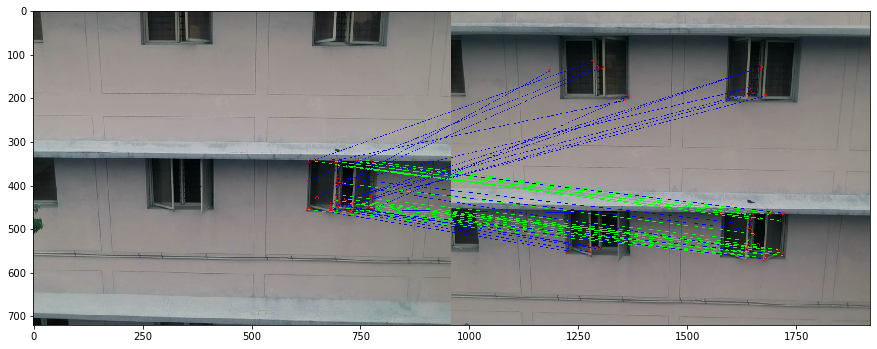

pick1: [[635, 345, 780, 460]]
pick2: [[625, 467, 765, 565], [265, 462, 407, 557], [229, 45, 424, 222], [637, 60, 787, 207]]
box2:  [625, 467, 765, 565]
pointB:  (682, 526)
listA:  []
ElementA:  [635, 345, 780, 460]
count:  0
oldBox
newCountInItr: 0
box2:  [265, 462, 407, 557]
pointB:  (682, 526)
listA:  [[635, 345, 780, 460]]
ElementA:  [635, 345, 780, 460]
count:  1
pointB:  (722, 545)
listA:  [[635, 345, 780, 460]]
ElementA:  [635, 345, 780, 460]
count:  1
pointB:  (681, 538)
listA:  [[635, 345, 780, 460]]
ElementA:  [635, 345, 780, 460]
count:  1
pointB:  (751, 480)
listA:  [[635, 345, 780, 460]]
ElementA:  [635, 345, 780, 460]
count:  1
pointB:  (675, 466)
listA:  [[635, 345, 780, 460]]
ElementA:  None
count:  0
pointB:  (759, 560)
listA:  [[635, 345, 780, 460]]
ElementA:  [635, 345, 780, 460]
count:  1
pointB:  (726, 461)
listA:  [[635, 345, 780, 460]]
ElementA:  None
count:  0
pointB:  (622, 464)
listA:  [[635, 345, 780, 460]]
ElementA:  None
count:  0
pointB:  (712, 545)
listA: 

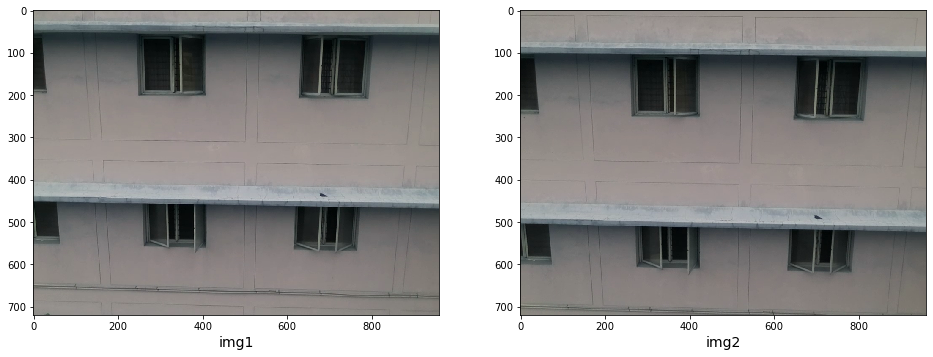

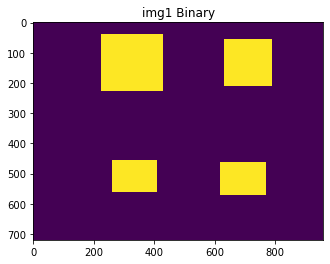

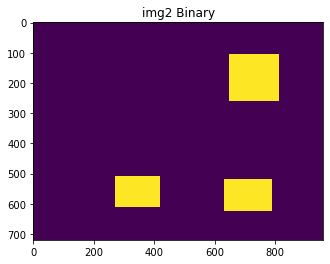

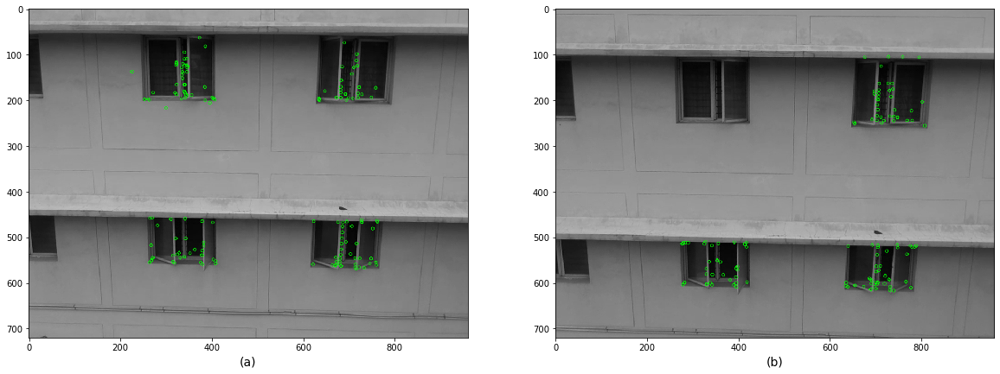

Using: bf feature matcher
Raw matches (Brute force): 82


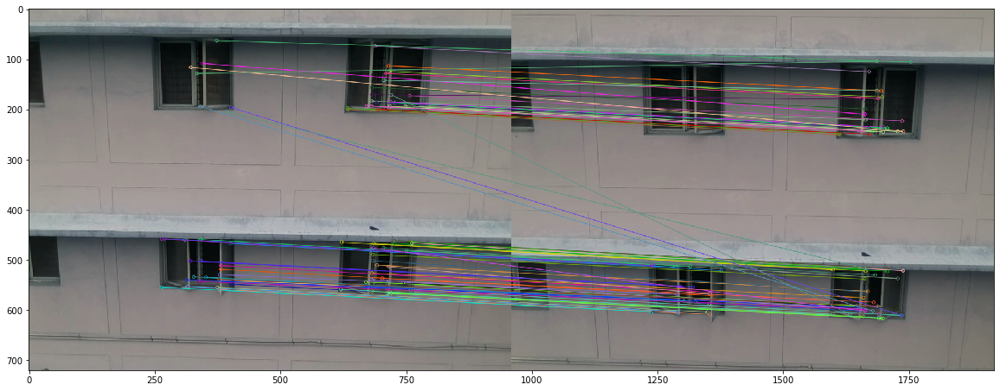

Final homography:  [[ 9.71183843e-01  1.02703585e-01 -1.41268801e+01]
 [-4.89717252e-02  1.04549426e+00  6.53824719e+01]
 [-1.04394079e-04  1.46613128e-04  1.00000000e+00]]
Final inliers count:  50
Inliers: [matrix([[682.69152832, 526.22314453, 700.17010498, 575.12091064]]), matrix([[403.22155762, 548.38964844, 418.09967041, 597.68566895]]), matrix([[310.3196106 , 460.10934448, 325.06881714, 513.99243164]]), matrix([[692.93347168, 510.09411621, 709.27416992, 562.56121826]]), matrix([[352.18621826, 534.16119385, 366.48687744, 581.95819092]]), matrix([[321.33670044, 502.22323608, 336.05871582, 552.56689453]]), matrix([[727.75634766, 187.04804993, 746.97259521, 237.2984314 ]]), matrix([[379.5093689 , 558.81665039, 394.99703979, 608.35858154]]), matrix([[713.48297119, 558.94708252, 731.03442383, 608.1282959 ]]), matrix([[751.52575684, 480.77682495, 767.69268799, 536.5814209 ]]), matrix([[401.88113403, 467.00558472, 417.37817383, 520.73046875]]), matrix([[378.902771  , 539.08410645, 393.965

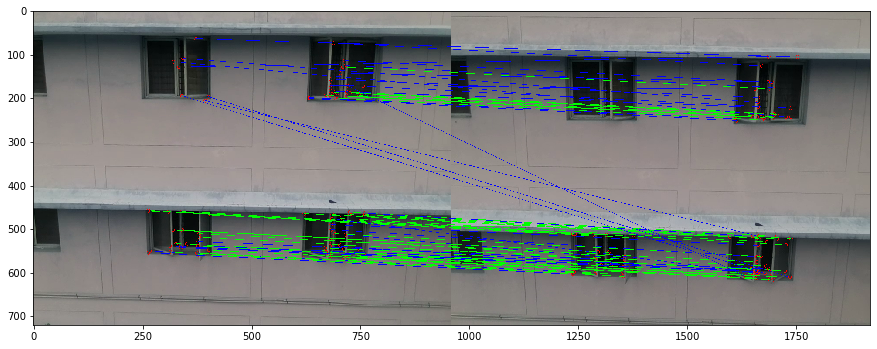

pick1: [[625, 467, 765, 565], [265, 462, 407, 557], [229, 45, 424, 222], [637, 60, 787, 207]]
pick2: [[637, 522, 785, 620], [277, 515, 415, 607], [655, 110, 810, 257]]
box2:  [637, 522, 785, 620]
pointB:  (700, 575)
listA:  []
ElementA:  [625, 467, 765, 565]
count:  0
oldBox
newCountInItr: 0
box2:  [277, 515, 415, 607]
pointB:  (700, 575)
listA:  [[625, 467, 765, 565]]
ElementA:  [625, 467, 765, 565]
count:  1
pointB:  (418, 597)
listA:  [[625, 467, 765, 565]]
ElementA:  [265, 462, 407, 557]
count:  0
pointB:  (325, 513)
listA:  [[625, 467, 765, 565]]
ElementA:  None
count:  0
pointB:  (709, 562)
listA:  [[625, 467, 765, 565]]
ElementA:  [625, 467, 765, 565]
count:  1
pointB:  (366, 581)
listA:  [[625, 467, 765, 565]]
ElementA:  [265, 462, 407, 557]
count:  0
oldBox
newCountInItr: 0
box2:  [655, 110, 810, 257]
pointB:  (700, 575)
listA:  [[625, 467, 765, 565], [265, 462, 407, 557]]
ElementA:  [625, 467, 765, 565]
count:  1
pointB:  (418, 597)
listA:  [[625, 467, 765, 565], [265, 462, 4

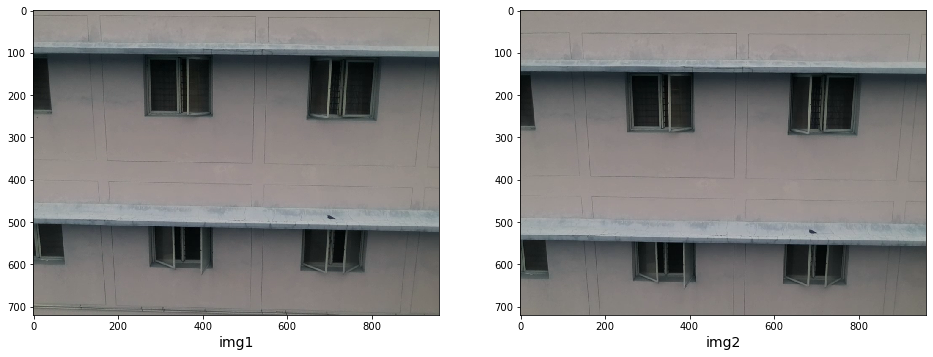

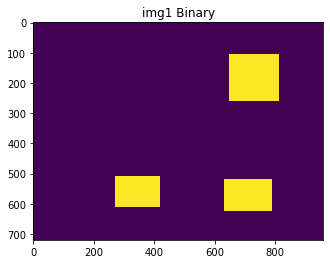

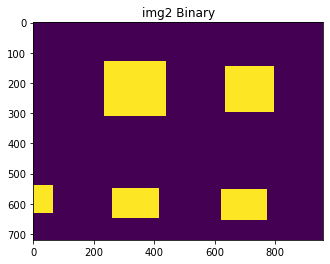

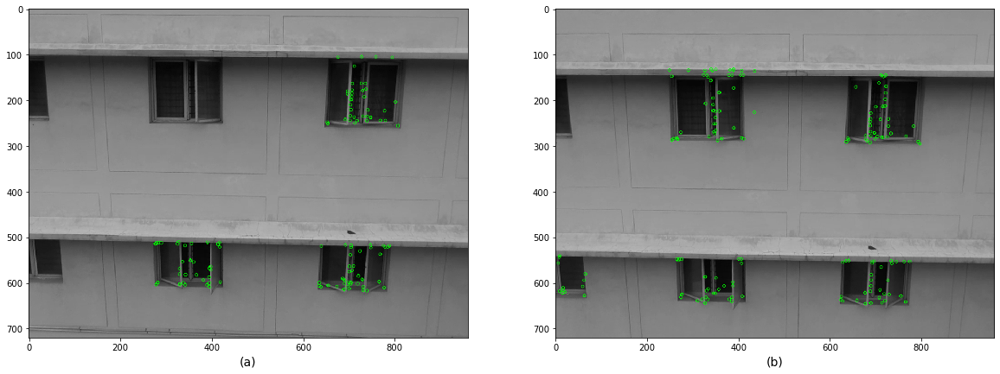

Using: bf feature matcher
Raw matches (Brute force): 91


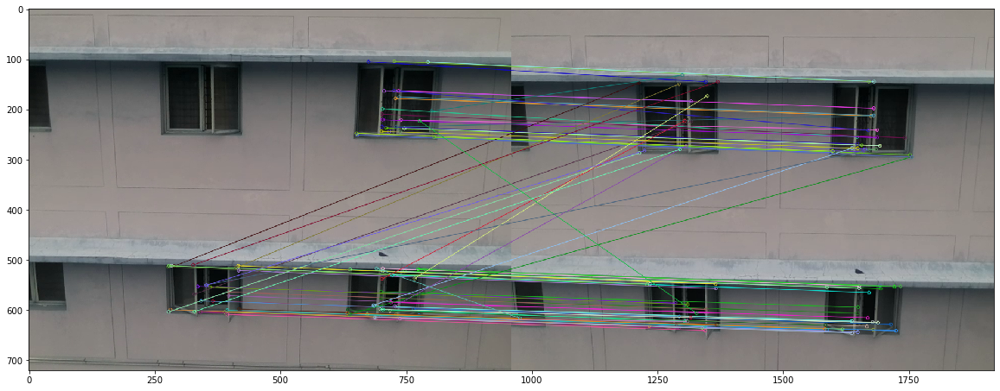

Final homography:  [[ 1.09461870e+00  6.50406397e-02 -6.03194322e+01]
 [ 2.54576383e-02  1.09367096e+00  8.77839806e+00]
 [ 4.70364297e-05  8.25979675e-05  1.00000000e+00]]
Final inliers count:  57
Inliers: [matrix([[389.4637146 , 603.59075928, 379.38821411, 635.49822998]]), matrix([[417.37817383, 520.73046875, 406.76116943, 556.73742676]]), matrix([[746.97259521, 237.2984314 , 732.66229248, 272.41049194]]), matrix([[718.51000977, 601.38360596, 706.81048584, 631.91607666]]), matrix([[765.796875  , 596.96893311, 754.30859375, 628.28112793]]), matrix([[729.77032471, 592.95916748, 718.1026001 , 623.56152344]]), matrix([[710.75531006, 236.86541748, 696.54663086, 271.3626709 ]]), matrix([[336.05871582, 552.56689453, 326.66815186, 586.04266357]]), matrix([[765.796875  , 596.96893311, 754.30859375, 628.28112793]]), matrix([[700.83868408, 563.14068604, 689.04742432, 593.72503662]]), matrix([[746.97259521, 237.2984314 , 732.66229248, 272.41049194]]), matrix([[360.20474243, 553.75177002, 350.476

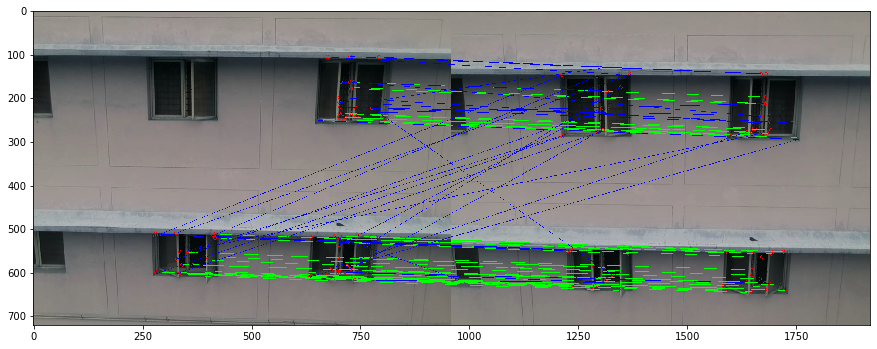

pick1: [[637, 522, 785, 620], [277, 515, 415, 607], [655, 110, 810, 257]]
pick2: [[627, 555, 770, 650], [267, 552, 412, 642], [0, 545, 62, 627], [239, 135, 436, 307], [640, 150, 792, 292]]
box2:  [627, 555, 770, 650]
pointB:  (379, 635)
listA:  []
ElementA:  [277, 515, 415, 607]
count:  0
pointB:  (406, 556)
listA:  []
ElementA:  None
count:  0
pointB:  (732, 272)
listA:  []
ElementA:  [655, 110, 810, 257]
count:  0
pointB:  (706, 631)
listA:  []
ElementA:  [637, 522, 785, 620]
count:  0
oldBox
newCountInItr: 0
box2:  [267, 552, 412, 642]
pointB:  (379, 635)
listA:  [[637, 522, 785, 620]]
ElementA:  [277, 515, 415, 607]
count:  0
oldBox
newCountInItr: 0
box2:  [0, 545, 62, 627]
pointB:  (379, 635)
listA:  [[637, 522, 785, 620], [277, 515, 415, 607]]
ElementA:  [277, 515, 415, 607]
count:  1
pointB:  (406, 556)
listA:  [[637, 522, 785, 620], [277, 515, 415, 607]]
ElementA:  None
count:  0
pointB:  (732, 272)
listA:  [[637, 522, 785, 620], [277, 515, 415, 607]]
ElementA:  [655, 110, 810,

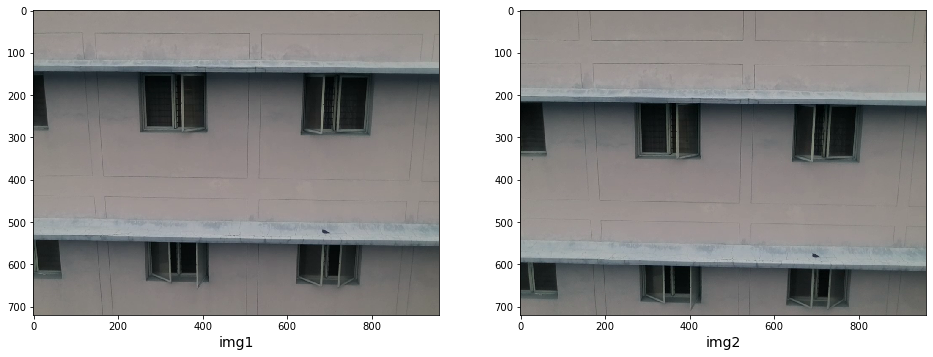

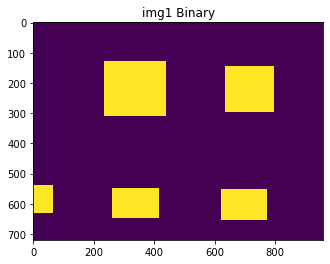

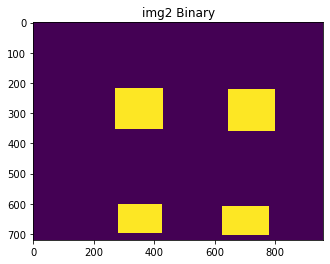

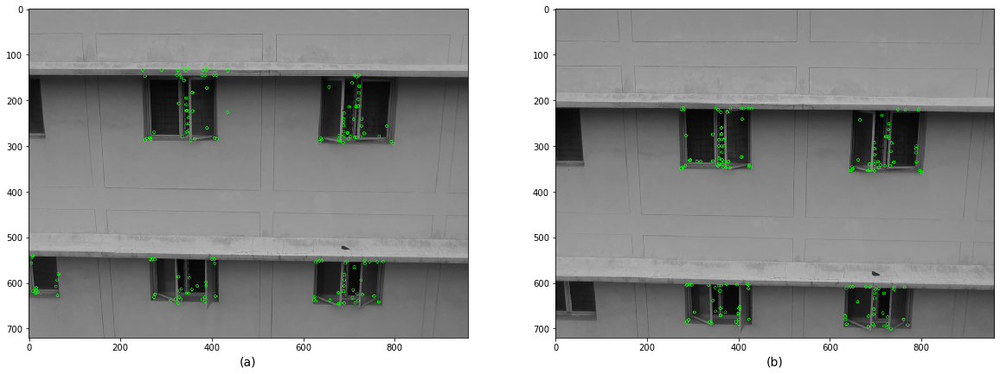

Using: bf feature matcher
Raw matches (Brute force): 119


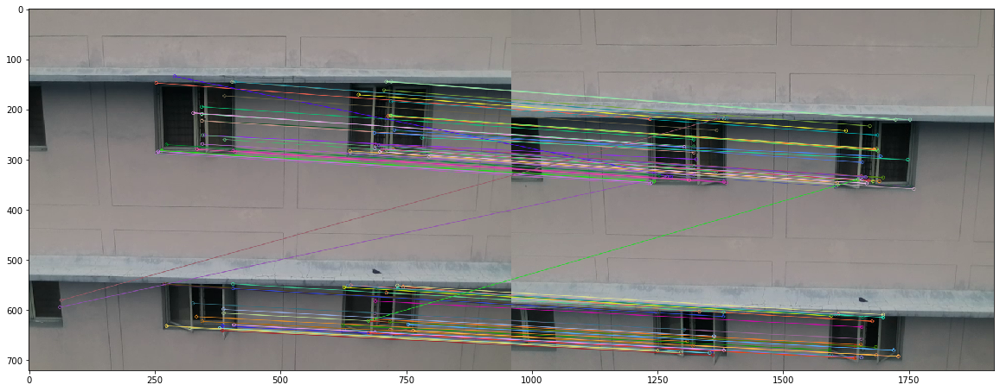

Final homography:  [[ 9.96325045e-01 -1.75068056e-02  2.69364221e+01]
 [ 1.52979332e-02  9.64124339e-01  6.89076921e+01]
 [ 3.42478283e-05 -2.37257529e-05  1.00000000e+00]]
Final inliers count:  87
Inliers: [matrix([[732.66229248, 272.41049194, 738.99279785, 335.76922607]]), matrix([[732.66229248, 272.41049194, 738.99279785, 335.76922607]]), matrix([[688.64465332, 643.40917969, 695.99615479, 693.9954834 ]]), matrix([[724.53552246, 280.01184082, 731.36853027, 343.17260742]]), matrix([[267.93746948, 550.10858154, 285.40756226, 605.34094238]]), matrix([[733.27575684, 551.08197021, 739.51727295, 608.77667236]]), matrix([[689.68328857, 581.69061279, 696.76123047, 633.32452393]]), matrix([[719.34729004, 212.52023315, 726.28344727, 278.47137451]]), matrix([[720.96826172, 184.12324524, 727.95568848, 251.4727478 ]]), matrix([[688.64465332, 643.40917969, 695.99615479, 693.9954834 ]]), matrix([[387.50466919, 605.65240479, 402.97259521, 657.77789307]]), matrix([[344.01348877, 209.31446838, 362.554

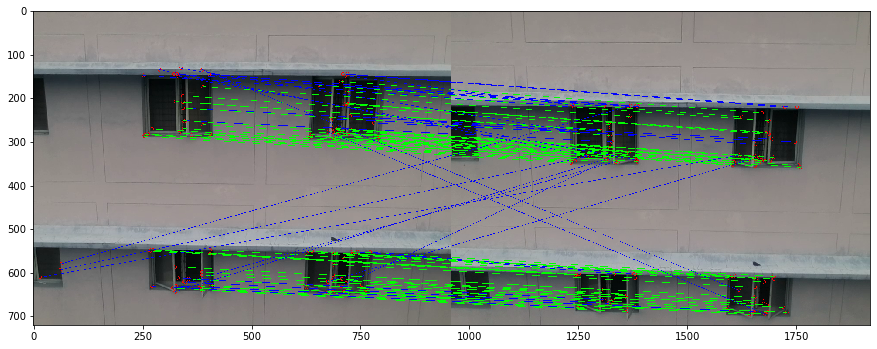

pick1: [[627, 555, 770, 650], [267, 552, 412, 642], [0, 545, 62, 627], [239, 135, 436, 307], [640, 150, 792, 292]]
pick2: [[632, 612, 777, 700], [287, 607, 422, 692], [650, 225, 797, 355], [275, 222, 425, 350]]
box2:  [632, 612, 777, 700]
pointB:  (738, 335)
listA:  []
ElementA:  [640, 150, 792, 292]
count:  0
pointB:  (738, 335)
listA:  []
ElementA:  [640, 150, 792, 292]
count:  0
pointB:  (695, 693)
listA:  []
ElementA:  [627, 555, 770, 650]
count:  0
oldBox
newCountInItr: 0
box2:  [287, 607, 422, 692]
pointB:  (738, 335)
listA:  [[627, 555, 770, 650]]
ElementA:  [640, 150, 792, 292]
count:  0
pointB:  (738, 335)
listA:  [[627, 555, 770, 650]]
ElementA:  [640, 150, 792, 292]
count:  0
pointB:  (695, 693)
listA:  [[627, 555, 770, 650]]
ElementA:  [627, 555, 770, 650]
count:  1
pointB:  (731, 343)
listA:  [[627, 555, 770, 650]]
ElementA:  [640, 150, 792, 292]
count:  0
pointB:  (285, 605)
listA:  [[627, 555, 770, 650]]
ElementA:  None
count:  0
pointB:  (739, 608)
listA:  [[627, 555, 7

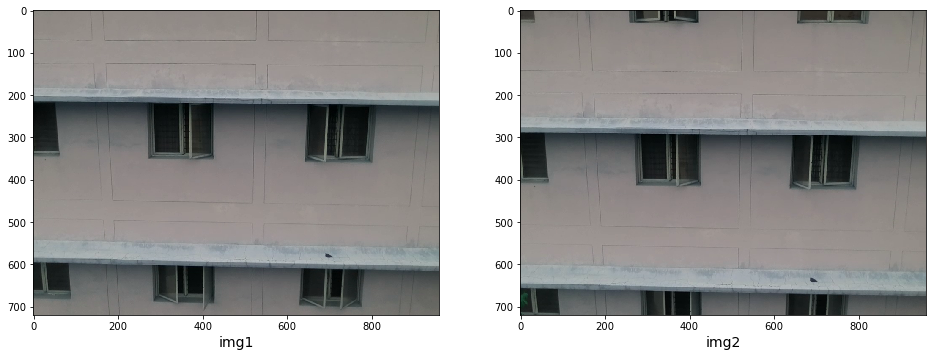

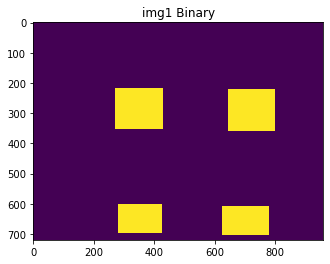

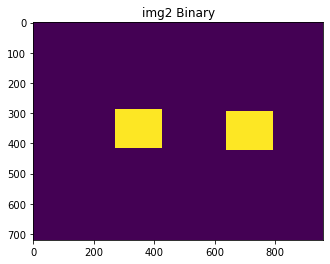

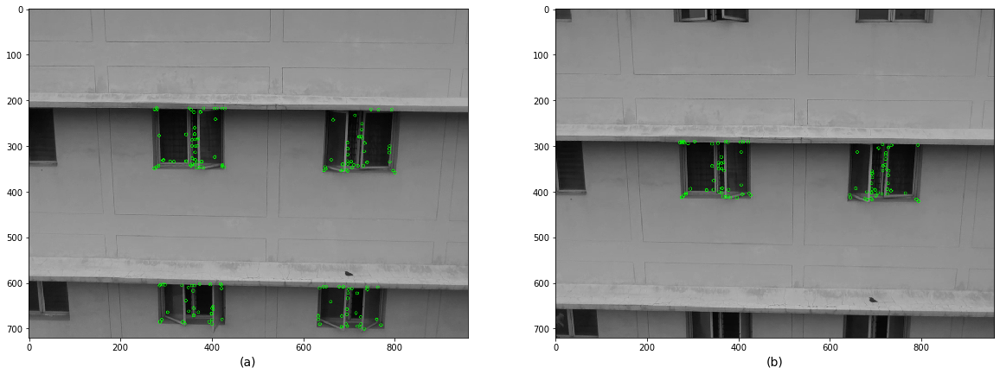

Using: bf feature matcher
Raw matches (Brute force): 80


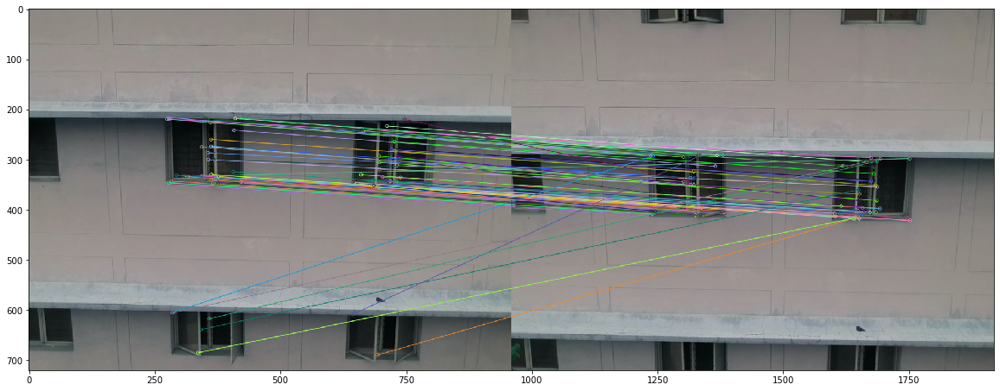

Final homography:  [[ 1.01561492e+00 -2.23557279e-02 -6.93147286e-01]
 [ 1.07449329e-02  9.07695948e-01  9.07123687e+01]
 [ 4.04847913e-05 -4.89112438e-05  1.00000000e+00]]
Final inliers count:  50
Inliers: [matrix([[738.99279785, 335.76922607, 732.98803711, 397.62322998]]), matrix([[738.99279785, 335.76922607, 732.98803711, 397.62322998]]), matrix([[704.03204346, 334.61019897, 698.24053955, 395.9223938 ]]), matrix([[704.03204346, 334.61019897, 698.24053955, 395.9223938 ]]), matrix([[726.28344727, 278.47137451, 719.98620605, 341.60324097]]), matrix([[695.95288086, 332.82495117, 690.30969238, 394.03393555]]), matrix([[648.74334717, 349.95852661, 644.02838135, 412.75967407]]), matrix([[408.1940918 , 241.47900391, 405.47833252, 313.18112183]]), matrix([[363.50750732, 330.0809021 , 363.55941772, 392.43890381]]), matrix([[731.36853027, 343.17260742, 724.8772583 , 405.27386475]]), matrix([[795.86181641, 353.96228027, 788.15911865, 416.32302856]]), matrix([[727.10095215, 264.39297485, 720.822

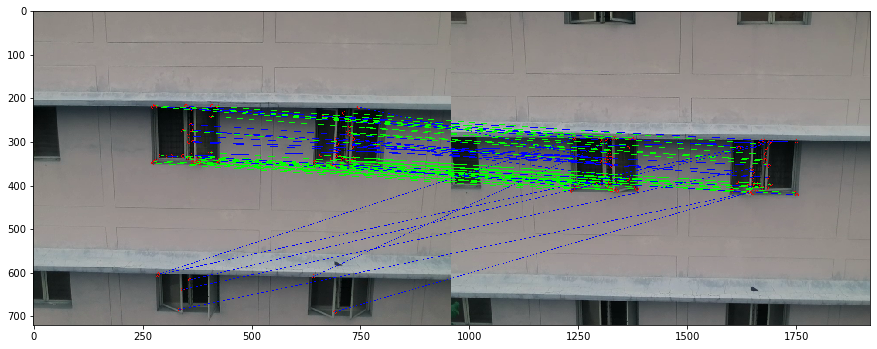

pick1: [[632, 612, 777, 700], [287, 607, 422, 692], [650, 225, 797, 355], [275, 222, 425, 350]]
pick2: [[645, 300, 790, 417], [275, 292, 422, 412]]
box2:  [645, 300, 790, 417]
pointB:  (732, 397)
listA:  []
ElementA:  [650, 225, 797, 355]
count:  0
oldBox
newCountInItr: 0
box2:  [275, 292, 422, 412]
pointB:  (732, 397)
listA:  [[650, 225, 797, 355]]
ElementA:  [650, 225, 797, 355]
count:  1
pointB:  (732, 397)
listA:  [[650, 225, 797, 355]]
ElementA:  [650, 225, 797, 355]
count:  1
pointB:  (698, 395)
listA:  [[650, 225, 797, 355]]
ElementA:  [650, 225, 797, 355]
count:  1
pointB:  (698, 395)
listA:  [[650, 225, 797, 355]]
ElementA:  [650, 225, 797, 355]
count:  1
pointB:  (719, 341)
listA:  [[650, 225, 797, 355]]
ElementA:  [650, 225, 797, 355]
count:  1
pointB:  (690, 394)
listA:  [[650, 225, 797, 355]]
ElementA:  [650, 225, 797, 355]
count:  1
pointB:  (644, 412)
listA:  [[650, 225, 797, 355]]
ElementA:  None
count:  0
pointB:  (405, 313)
listA:  [[650, 225, 797, 355]]
ElementA:  [2

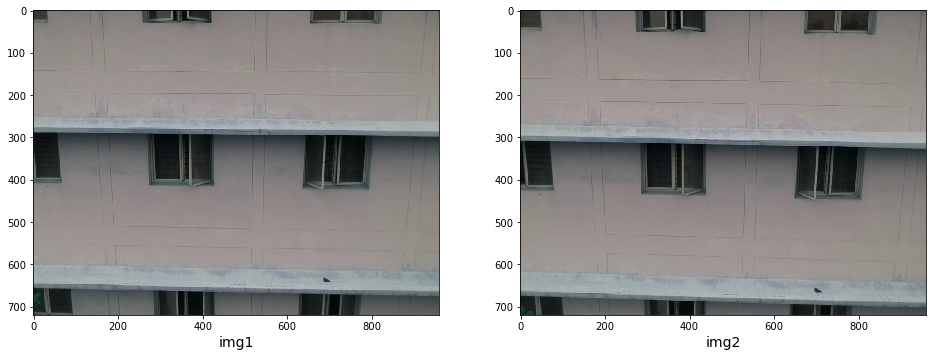

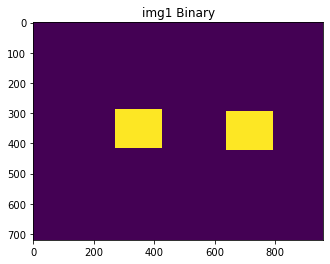

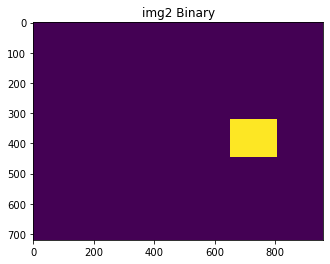

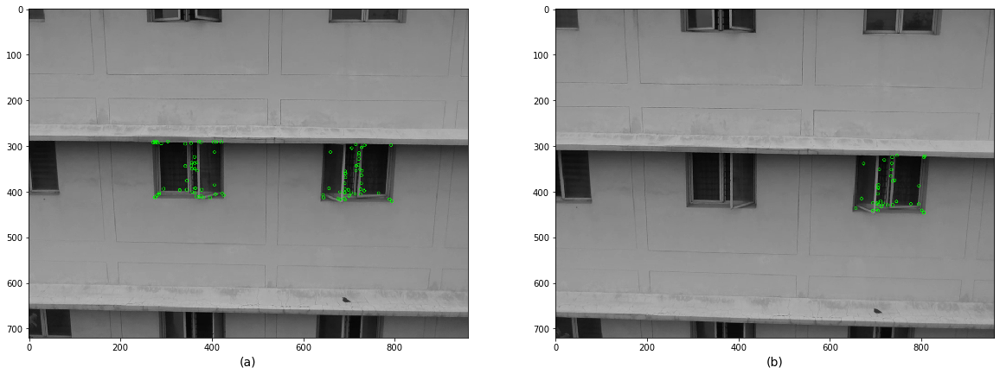

Using: bf feature matcher
Raw matches (Brute force): 38


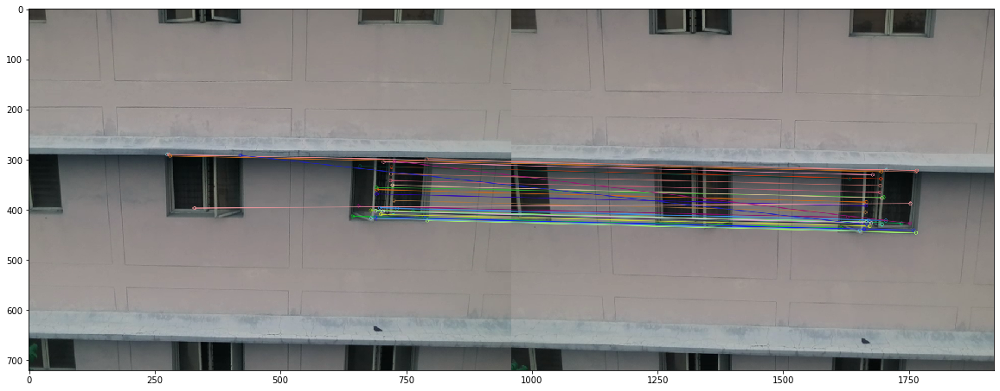

Final homography:  [[ 1.16027846e+00 -5.51396809e-02 -3.09988843e+01]
 [ 5.41160542e-02  1.03987185e+00 -1.43278558e+00]
 [ 1.25253357e-04 -5.57450183e-05  1.00000000e+00]]
Final inliers count:  30
Inliers: [matrix([[732.98803711, 397.62322998, 744.83929443, 421.40835571]]), matrix([[732.98803711, 397.62322998, 744.83929443, 421.40835571]]), matrix([[788.15911865, 416.32302856, 800.11151123, 440.85238647]]), matrix([[788.15911865, 416.32302856, 800.11151123, 440.85238647]]), matrix([[644.02838135, 412.75967407, 655.82592773, 435.98355103]]), matrix([[655.72003174, 392.67807007, 668.3114624 , 415.05197144]]), matrix([[721.61981201, 314.68774414, 734.53088379, 338.1036377 ]]), matrix([[764.33685303, 403.01989746, 775.93664551, 426.82519531]]), matrix([[692.03991699, 368.66958618, 705.01818848, 392.03540039]]), matrix([[719.98620605, 341.60324097, 732.53491211, 365.32983398]]), matrix([[724.8772583 , 405.27386475, 736.75195312, 429.38848877]]), matrix([[659.04449463, 313.11813354, 672.822

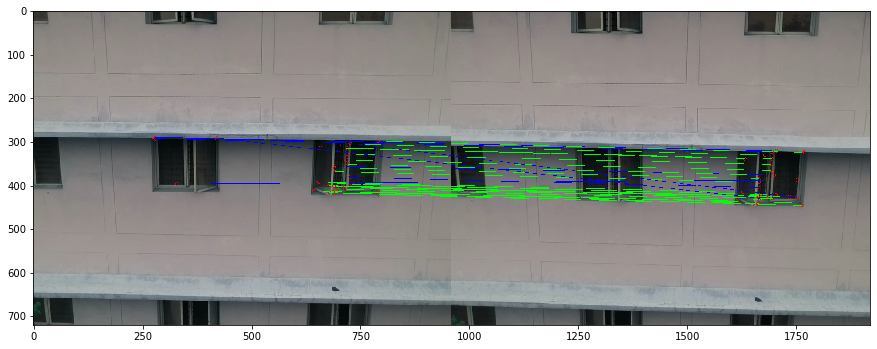

pick1: [[645, 300, 790, 417], [275, 292, 422, 412]]
pick2: [[657, 325, 802, 442]]
box2:  [657, 325, 802, 442]
pointB:  (744, 421)
listA:  []
ElementA:  [645, 300, 790, 417]
count:  0
oldBox
newCountInItr: 0
new Windows Count:  0


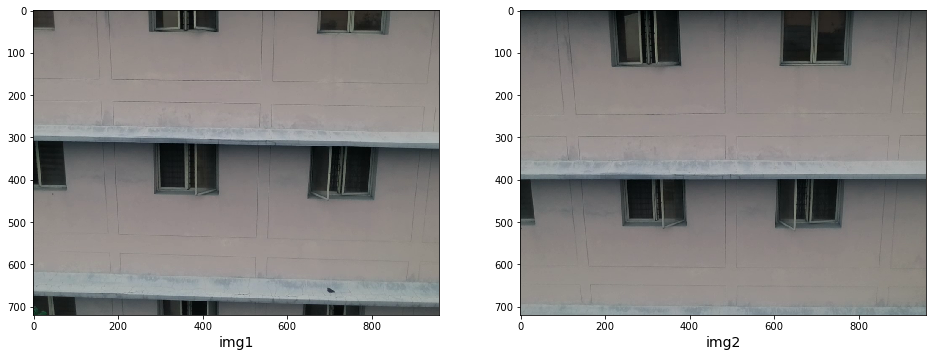

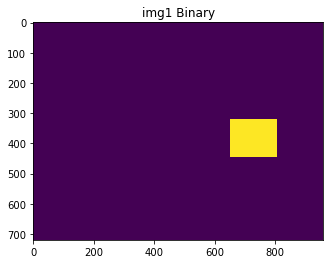

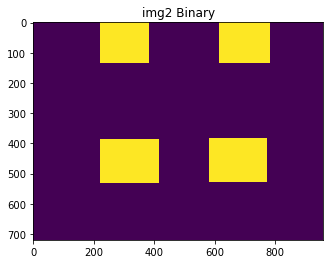

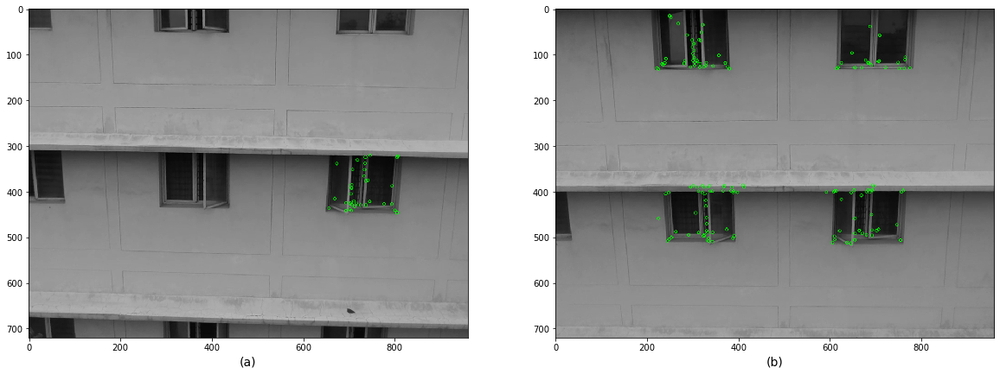

Using: bf feature matcher
Raw matches (Brute force): 36


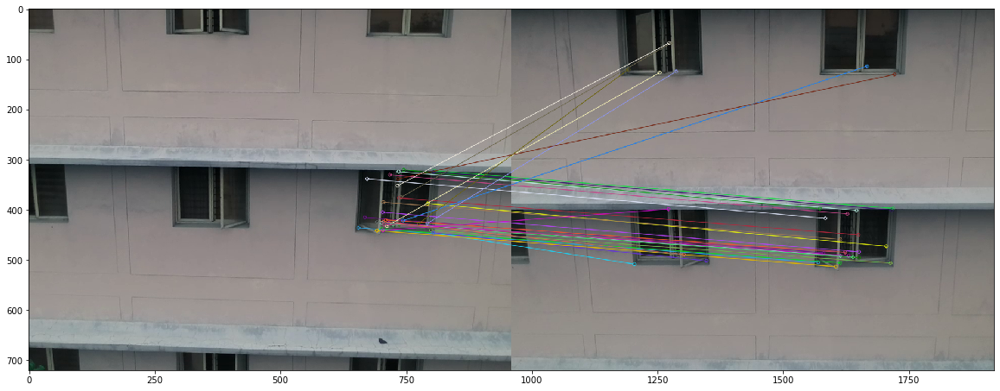

Final homography:  [[ 1.03975196e+00  2.09974419e-01 -1.12751858e+02]
 [-4.75682847e-02  1.09093530e+00  1.02213110e+02]
 [-5.08391442e-05  2.66852160e-04  1.00000000e+00]]
Final inliers count:  19
Inliers: [matrix([[800.11151123, 440.85238647, 753.72277832, 506.13937378]]), matrix([[702.09008789, 425.65625   , 654.13323975, 491.55844116]]), matrix([[800.11151123, 440.85238647, 753.72277832, 506.13937378]]), matrix([[735.42755127, 323.98345947, 686.26550293, 400.99917603]]), matrix([[668.3114624 , 415.05197144, 620.65484619, 485.63049316]]), matrix([[718.02966309, 330.34805298, 667.90814209, 408.2159729 ]]), matrix([[672.82202148, 338.3638916 , 624.16156006, 416.67242432]]), matrix([[655.82592773, 435.98355103, 610.05438232, 504.75131226]]), matrix([[736.75195312, 429.38848877, 691.00445557, 495.59963989]]), matrix([[806.46002197, 321.93148804, 759.26647949, 397.21914673]]), matrix([[804.55029297, 324.52828979, 755.68902588, 400.4621582 ]]), matrix([[701.43572998, 438.45144653, 653.966

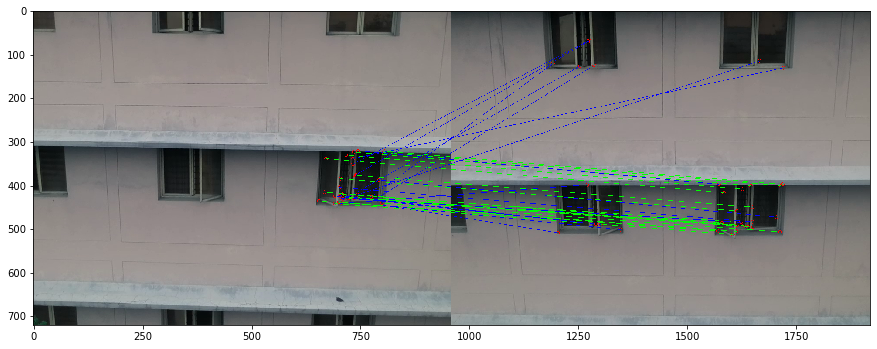

pick1: [[657, 325, 802, 442]]
pick2: [[227, 390, 412, 527], [588, 387, 768, 522], [620, 0, 780, 130], [227, 5, 380, 130]]
box2:  [227, 390, 412, 527]
pointB:  (753, 506)
listA:  []
ElementA:  [657, 325, 802, 442]
count:  0
pointB:  (654, 491)
listA:  []
ElementA:  [657, 325, 802, 442]
count:  0
pointB:  (753, 506)
listA:  []
ElementA:  [657, 325, 802, 442]
count:  0
pointB:  (686, 400)
listA:  []
ElementA:  None
count:  0
pointB:  (620, 485)
listA:  []
ElementA:  [657, 325, 802, 442]
count:  0
pointB:  (667, 408)
listA:  []
ElementA:  [657, 325, 802, 442]
count:  0
pointB:  (624, 416)
listA:  []
ElementA:  [657, 325, 802, 442]
count:  0
pointB:  (610, 504)
listA:  []
ElementA:  None
count:  0
pointB:  (691, 495)
listA:  []
ElementA:  [657, 325, 802, 442]
count:  0
pointB:  (759, 397)
listA:  []
ElementA:  None
count:  0
pointB:  (755, 400)
listA:  []
ElementA:  None
count:  0
pointB:  (653, 505)
listA:  []
ElementA:  [657, 325, 802, 442]
count:  0
pointB:  (654, 458)
listA:  []
Element

In [242]:

# grab the paths to the input images and initialize our images list
print("[INFO] loading images...")
imagePaths = sorted(list(paths.list_images(imgPath)))
images = []
# loop over the image paths, load each one, and add them to our
# images to stitch list
for imagePath in imagePaths:
    image = cv2.imread(imagePath, 1)
#     print(image.shape)
    images.append(image)
    print(imagePath)
    
print(images[0].shape)

windowCount = len(FinalList[0])

## MAIN LOOP ##
for i in range(len(images) - 1):
    img1 = images[i]
    img2 = images[i+1]
    
#     print(img1.shape)
    # read images and transform them to grayscale
    # Make sure that the train image is the image that will be transformed
    # Opencv defines the color channel in the order BGR 
    # Transform it to RGB to be compatible to matplotlib
    img1_gray = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)
    img2_gray = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

    fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, constrained_layout=False, figsize=(16,9))
    ax1.imshow(img1, cmap="gray")
    ax1.set_xlabel("img1", fontsize=14)
    ax2.imshow(img2, cmap="gray")
    ax2.set_xlabel("img2", fontsize=14)
    plt.show()
    
    ## Preparing Binary Mask and mapping bounding box coordinates
    ## COORDS1 and COORDS2 : WOULD COME FROM TEXT FILE
#     coords1 = batch_data_int[i]
#     coords1 = np.array(coords1)
#     print(coords1)
#     coords1 = coords1.reshape(-1, 2)
#     coords1 = np.reshape(coords1,(coords1.shape[0]//4 , 4, coords1.shape[1]))
    
#     coords2 = batch_data_int[i+1]
#     coords2 = np.array(coords2)
#     coords2 = coords2.reshape(-1,2)
#     coords2 = np.reshape(coords2,(coords2.shape[0]//4 , 4, coords2.shape[1]))
    
    coords1 = FinalList[i]
    coords2 = FinalList[i+1]
#     print(coords1)
    
    img1_binary = prepareBinaryMask(img1_gray, coords1)
    img2_binary = prepareBinaryMask(img2_gray, coords2)
    plt.figure()
    plt.title('img1 Binary')
    plt.imshow(img1_binary)
    plt.show()
    plt.title('img2 Binary')
    plt.imshow(img2_binary)
    plt.show()

    ## Commented as the coords would come from recorded text File.
    ## LEFT TO DO
    pick1 = mapToPickv1(coords1)
    pick2 = mapToPickv1(coords2)
        
    kpsA, featuresA = detectAndDescribe(img1_gray, img1_binary, method=feature_extractor)
    kpsB, featuresB = detectAndDescribe(img2_gray, img2_binary, method=feature_extractor)
#     print('featuresA: ')
#     print(featuresA)
#     print('featuresB: ')
#     print(featuresB)
#     print(len(kpsA))
#     print(kpsB)
    
    # display the keypoints and features detected on both images
    fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
    ax1.imshow(cv2.drawKeypoints(img1_gray,kpsA,None,color=(0,255,0)))
    ax1.set_xlabel("(a)", fontsize=14)
    ax2.imshow(cv2.drawKeypoints(img2_gray,kpsB,None,color=(0,255,0)))
    ax2.set_xlabel("(b)", fontsize=14)
    plt.show()
    
    # Match Feature Points
    print("Using: {} feature matcher".format(feature_matching))
    fig = plt.figure(figsize=(20,8))
    if feature_matching == 'bf':
        matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
        img3 = cv2.drawMatches(img1,kpsA,img2,kpsB,matches[:100],
                               None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    elif feature_matching == 'knn':
        matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.75, method=feature_extractor)
        img3 = cv2.drawMatches(img1,kpsA,img2,kpsB,np.random.choice(matches,100),
                               None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img3)
    plt.show()
    
    ## Calculating homography and rejecting outliers
    correspondenceList = []
    estimation_thresh = 0.60
    for match in matches:
        (x1, y1) = kpsA[match.queryIdx].pt
        (x2, y2) = kpsB[match.trainIdx].pt
        correspondenceList.append([x1, y1, x2, y2])

    corrs = np.matrix(correspondenceList)

    #run ransac algorithm
    finalH, inliers = ransac(corrs, estimation_thresh)
    print("Final homography: ", finalH)
    print("Final inliers count: ", len(inliers))
    print("Inliers: " +  str(inliers))
    img3 = drawMatches(img1,kpsA,img2,kpsB, matches, inliers)
    plt.figure(figsize=(15,15))
    plt.imshow(img3)
    plt.show()

    ## Converting to numpy array = INLIERS
    inliers_Arr = np.array(inliers)
    inliers = np.squeeze(inliers_Arr, axis = 1).tolist()
    
    print("pick1:", pick1)
    print("pick2:", pick2)
    newWindows, newWindowsCount = calculateUnMatchedWindows(inliers, pick1, pick2)
    windowCount += newWindowsCount

print('Total windows are:', windowCount)